In [58]:
pwd

'C:\\Users\\Lejith'

In [8]:
# To partition the data
from sklearn.model_selection import train_test_split

# Importing library for logistic regression
from sklearn.linear_model import LogisticRegression

# Importing performance metrics - accuracy score & confusion matrix
from sklearn.metrics import accuracy_score,confusion_matrix

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
hr1_data=pd.read_csv("People Charm case.csv")
hr_data=hr1_data.copy()
hr_data

,satisfactoryLevel,lastEvaluation,numberOfProjects,avgMonthlyHours,timeSpent.company,workAccident,left,promotionInLast5years,dept,salary
0,0.38,0.53,2,157,3,0,1,0,sales,low
1,0.80,0.86,5,262,6,0,1,0,sales,medium
2,0.11,0.88,7,272,4,0,1,0,sales,medium
3,0.37,0.52,2,159,3,0,1,0,sales,low
4,0.41,0.50,2,153,3,0,1,0,sales,low
...,...,...,...,...,...,...,...,...,...,...
14994,0.11,0.85,7,275,4,0,1,0,support,medium
14995,0.99,0.83,4,274,2,0,0,0,sales,low
14996,0.72,0.72,4,175,4,0,0,0,technical,low
14997,0.24,0.91,5,177,5,0,0,0,sales,low


In [61]:
hr_data.isnull().sum()

satisfactoryLevel        0
lastEvaluation           0
numberOfProjects         0
avgMonthlyHours          0
timeSpent.company        0
workAccident             0
left                     0
promotionInLast5years    0
dept                     0
salary                   0
dtype: int64

In [62]:
hr_data.shape

(14999, 10)

In [63]:
hr_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14999 entries, 0 to 14998
Data columns (total 10 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   satisfactoryLevel      14999 non-null  float64
 1   lastEvaluation         14999 non-null  float64
 2   numberOfProjects       14999 non-null  int64  
 3   avgMonthlyHours        14999 non-null  int64  
 4   timeSpent.company      14999 non-null  int64  
 5   workAccident           14999 non-null  int64  
 6   left                   14999 non-null  int64  
 7   promotionInLast5years  14999 non-null  int64  
 8   dept                   14999 non-null  object 
 9   salary                 14999 non-null  object 
dtypes: float64(2), int64(6), object(2)
memory usage: 1.1+ MB


In [64]:
hr_data['dept'].unique()

array(['sales', 'accounting', 'hr', 'technical', 'support', 'IT',
       'product_mng', 'marketing', 'management', 'RandD'], dtype=object)

In [65]:
hr_data

,satisfactoryLevel,lastEvaluation,numberOfProjects,avgMonthlyHours,timeSpent.company,workAccident,left,promotionInLast5years,dept,salary
0,0.38,0.53,2,157,3,0,1,0,sales,low
1,0.80,0.86,5,262,6,0,1,0,sales,medium
2,0.11,0.88,7,272,4,0,1,0,sales,medium
3,0.37,0.52,2,159,3,0,1,0,sales,low
4,0.41,0.50,2,153,3,0,1,0,sales,low
...,...,...,...,...,...,...,...,...,...,...
14994,0.11,0.85,7,275,4,0,1,0,support,medium
14995,0.99,0.83,4,274,2,0,0,0,sales,low
14996,0.72,0.72,4,175,4,0,0,0,technical,low
14997,0.24,0.91,5,177,5,0,0,0,sales,low


In [66]:
hr_data.describe()

,satisfactoryLevel,lastEvaluation,numberOfProjects,avgMonthlyHours,timeSpent.company,workAccident,left,promotionInLast5years
count,14999.000000,14999.000000,14999.000000,14999.000000,14999.000000,14999.000000,14999.000000,14999.000000
mean,0.612834,0.716102,3.803054,201.050337,3.498233,0.144610,0.238083,0.021268
std,0.248631,0.171169,1.232592,49.943099,1.460136,0.351719,0.425924,0.144281
min,0.090000,0.360000,2.000000,96.000000,2.000000,0.000000,0.000000,0.000000
25%,0.440000,0.560000,3.000000,156.000000,3.000000,0.000000,0.000000,0.000000
50%,0.640000,0.720000,4.000000,200.000000,3.000000,0.000000,0.000000,0.000000
75%,0.820000,0.870000,5.000000,245.000000,4.000000,0.000000,0.000000,0.000000
max,1.000000,1.000000,7.000000,310.000000,10.000000,1.000000,1.000000,1.000000


In [67]:
hr_data.describe(include='object')

,dept,salary
count,14999,14999
unique,10,3
top,sales,low
freq,4140,7316


In [68]:
hr_data['dept'].value_counts()

sales          4140
technical      2720
support        2229
IT             1227
product_mng     902
marketing       858
RandD           787
accounting      767
hr              739
management      630
Name: dept, dtype: int64

In [154]:
hr_data['salary'].value_counts()

low       7316
medium    6446
high      1237
Name: salary, dtype: int64

In [69]:
hr_data['left'].unique()

array([1, 0], dtype=int64)

In [70]:
hr_data['satisfactoryLevel'].unique()

array([0.38, 0.8 , 0.11, 0.37, 0.41, 0.1 , 0.92, 0.42, 0.45, 0.36, 0.78,
       0.76, 0.09, 0.46, 0.4 , 0.89, 0.82, 0.84, 0.87, 0.57, 0.43, 0.13,
       0.39, 0.74, 0.79, 0.44, 0.9 , 0.71, 0.7 , 0.31, 0.73, 0.83, 0.32,
       0.54, 0.77, 0.88, 0.85, 0.48, 0.81, 0.12, 0.61, 0.91, 0.86, 0.56,
       0.75, 0.47, 0.28, 0.55, 0.59, 0.53, 0.66, 0.72, 0.34, 0.64, 0.23,
       0.15, 0.14, 0.3 , 0.35, 0.62, 0.51, 0.29, 0.2 , 0.63, 0.16, 0.17,
       0.6 , 0.65, 0.49, 0.68, 0.67, 0.26, 0.99, 0.5 , 1.  , 0.24, 0.19,
       0.52, 0.98, 0.33, 0.58, 0.93, 0.69, 0.96, 0.97, 0.27, 0.22, 0.95,
       0.94, 0.18, 0.21, 0.25])

In [71]:
hr_data['lastEvaluation'].unique()

array([0.53, 0.86, 0.88, 0.52, 0.5 , 0.77, 0.85, 0.54, 0.81, 0.56, 0.47,
       0.99, 0.89, 0.83, 0.95, 0.57, 0.92, 0.87, 0.49, 0.62, 0.51, 0.46,
       0.8 , 0.7 , 0.78, 0.97, 0.79, 0.59, 0.45, 1.  , 0.84, 0.94, 0.96,
       0.48, 0.82, 0.91, 0.98, 0.55, 0.74, 0.9 , 0.93, 0.71, 0.6 , 0.65,
       0.72, 0.67, 0.75, 0.58, 0.73, 0.63, 0.68, 0.61, 0.76, 0.66, 0.69,
       0.37, 0.41, 0.43, 0.64, 0.44, 0.39, 0.4 , 0.38, 0.42, 0.36])

In [72]:
hr_data['salary'].unique()

array(['low', 'medium', 'high'], dtype=object)

In [24]:
hr_leftdata=hr_data[hr_data['left']==1]
hr_staydata=hr_data[hr_data['left']==0]

In [74]:
hr_promodata=hr_data[hr_data['promotionInLast5years']==1]
print(hr_promodata.count())
hr_promodata[hr_promodata['left']==1].count()

satisfactoryLevel        319
lastEvaluation           319
numberOfProjects         319
avgMonthlyHours          319
timeSpent.company        319
workAccident             319
left                     319
promotionInLast5years    319
dept                     319
salary                   319
dtype: int64


satisfactoryLevel        19
lastEvaluation           19
numberOfProjects         19
avgMonthlyHours          19
timeSpent.company        19
workAccident             19
left                     19
promotionInLast5years    19
dept                     19
salary                   19
dtype: int64

In [75]:
hr_workaccdata=hr_data[hr_data['workAccident']==1]
print(hr_workaccdata.count())
hr_workaccdata[hr_workaccdata['left']==1].count()

satisfactoryLevel        2169
lastEvaluation           2169
numberOfProjects         2169
avgMonthlyHours          2169
timeSpent.company        2169
workAccident             2169
left                     2169
promotionInLast5years    2169
dept                     2169
salary                   2169
dtype: int64


satisfactoryLevel        169
lastEvaluation           169
numberOfProjects         169
avgMonthlyHours          169
timeSpent.company        169
workAccident             169
left                     169
promotionInLast5years    169
dept                     169
salary                   169
dtype: int64

In [76]:
hr_leftdata.shape

(3571, 10)

In [77]:
hr_data.groupby('left').mean()

,satisfactoryLevel,lastEvaluation,numberOfProjects,avgMonthlyHours,timeSpent.company,workAccident,promotionInLast5years
left,,,,,,,
0,0.666810,0.715473,3.786664,199.060203,3.380032,0.175009,0.026251
1,0.440098,0.718113,3.855503,207.419210,3.876505,0.047326,0.005321


In [78]:
hr_data.groupby('dept').mean()

,satisfactoryLevel,lastEvaluation,numberOfProjects,avgMonthlyHours,timeSpent.company,workAccident,left,promotionInLast5years
dept,,,,,,,,
IT,0.618142,0.716830,3.816626,202.215974,3.468623,0.133659,0.222494,0.002445
RandD,0.619822,0.712122,3.853875,200.800508,3.367217,0.170267,0.153748,0.034307
accounting,0.582151,0.717718,3.825293,201.162973,3.522816,0.125163,0.265971,0.018253
hr,0.598809,0.708850,3.654939,198.684709,3.355886,0.120433,0.290934,0.020298
management,0.621349,0.724000,3.860317,201.249206,4.303175,0.163492,0.144444,0.109524
marketing,0.618601,0.715886,3.687646,199.385781,3.569930,0.160839,0.236597,0.050117
product_mng,0.619634,0.714756,3.807095,199.965632,3.475610,0.146341,0.219512,0.000000
sales,0.614447,0.709717,3.776329,200.911353,3.534058,0.141787,0.244928,0.024155
support,0.618300,0.723109,3.803948,200.758188,3.393001,0.154778,0.248991,0.008973


In [79]:
hr_data.groupby('salary').mean()

,satisfactoryLevel,lastEvaluation,numberOfProjects,avgMonthlyHours,timeSpent.company,workAccident,left,promotionInLast5years
salary,,,,,,,,
high,0.637470,0.704325,3.767179,199.867421,3.692805,0.155214,0.066289,0.058205
low,0.600753,0.717017,3.799891,200.996583,3.438218,0.142154,0.296884,0.009021
medium,0.621817,0.717322,3.813528,201.338349,3.529010,0.145361,0.204313,0.028079


In [168]:
hr_data[hr_data['left']==0].count()

satisfactoryLevel        11428
lastEvaluation           11428
numberOfProjects         11428
avgMonthlyHours          11428
timeSpent.company        11428
workAccident             11428
left                     11428
promotionInLast5years    11428
dept                     11428
salary                   11428
dtype: int64

In [80]:
hr_leastsatis=hr_data[hr_data['satisfactoryLevel']<0.4]
hr_leastsatis.count()

satisfactoryLevel        2915
lastEvaluation           2915
numberOfProjects         2915
avgMonthlyHours          2915
timeSpent.company        2915
workAccident             2915
left                     2915
promotionInLast5years    2915
dept                     2915
salary                   2915
dtype: int64

In [81]:
import numpy as np
corr_matrix=hr_data.corr()
corr_matrix

,satisfactoryLevel,lastEvaluation,numberOfProjects,avgMonthlyHours,timeSpent.company,workAccident,left,promotionInLast5years
satisfactoryLevel,1.000000,0.105021,-0.142970,-0.020048,-0.100866,0.058697,-0.388375,0.025605
lastEvaluation,0.105021,1.000000,0.349333,0.339742,0.131591,-0.007104,0.006567,-0.008684
numberOfProjects,-0.142970,0.349333,1.000000,0.417211,0.196786,-0.004741,0.023787,-0.006064
avgMonthlyHours,-0.020048,0.339742,0.417211,1.000000,0.127755,-0.010143,0.071287,-0.003544
timeSpent.company,-0.100866,0.131591,0.196786,0.127755,1.000000,0.002120,0.144822,0.067433
workAccident,0.058697,-0.007104,-0.004741,-0.010143,0.002120,1.000000,-0.154622,0.039245
left,-0.388375,0.006567,0.023787,0.071287,0.144822,-0.154622,1.000000,-0.061788
promotionInLast5years,0.025605,-0.008684,-0.006064,-0.003544,0.067433,0.039245,-0.061788,1.000000


In [171]:
dept=pd.crosstab(index=hr_data['dept'],columns='count',normalize=True)
dept

col_0,count
dept,
IT,0.081805
RandD,0.052470
accounting,0.051137
hr,0.049270
management,0.042003
marketing,0.057204
product_mng,0.060137
sales,0.276018
support,0.148610


In [172]:
salary=pd.crosstab(index=hr_data['salary'],columns='count',normalize=True)
salary

col_0,count
salary,
high,0.082472
low,0.487766
medium,0.429762


In [173]:
left=pd.crosstab(index=hr_data['left'],columns='count',margins=True,)
left

col_0,count,All
left,,
0,11428,11428
1,3571,3571
All,14999,14999


In [174]:
salary_left=pd.crosstab(index=hr_data['salary'],columns=hr_data['left'],margins=True,normalize='index')
salary_left

left,0,1
salary,,
high,0.933711,0.066289
low,0.703116,0.296884
medium,0.795687,0.204313
All,0.761917,0.238083


In [175]:
satisfaction_left=pd.crosstab(index=hr_data['satisfactoryLevel'],columns=hr_data['left'],margins=True,normalize='index')
satisfaction_left.head(85)

left,0,1
satisfactoryLevel,,
0.09,0.000000,1.000000
0.10,0.000000,1.000000
0.11,0.000000,1.000000
0.12,0.866667,0.133333
0.13,0.944444,0.055556
...,...,...
0.89,0.763713,0.236287
0.90,0.763636,0.236364
0.91,0.808036,0.191964


In [176]:
lasteval_left=pd.crosstab(index=hr_data['lastEvaluation'],columns=hr_data['left'],margins=True,normalize='index')
lasteval_left

left,0,1
lastEvaluation,,
0.36,1.000000,0.000000
0.37,1.000000,0.000000
0.38,1.000000,0.000000
0.39,1.000000,0.000000
0.4,1.000000,0.000000
...,...,...
0.97,0.695652,0.304348
0.98,0.756654,0.243346
0.99,0.744186,0.255814


In [178]:
noofProjects_left=pd.crosstab(index=hr_data['numberOfProjects'],columns=hr_data['left'],margins=True,normalize='index')
noofProjects_left

left,0,1
numberOfProjects,,
2,0.343802,0.656198
3,0.982244,0.017756
4,0.906300,0.093700
5,0.778341,0.221659
6,0.442078,0.557922
7,0.000000,1.000000
All,0.761917,0.238083


In [179]:
timespent_left=pd.crosstab(index=hr_data['timeSpent.company'],columns=hr_data['left'],margins=True,normalize='index')
timespent_left

left,0,1
timeSpent.company,,
2,0.983662,0.016338
3,0.753841,0.246159
4,0.651936,0.348064
5,0.434487,0.565513
6,0.708914,0.291086
7,1.000000,0.000000
8,1.000000,0.000000
10,1.000000,0.000000
All,0.761917,0.238083


In [45]:
dept_left=pd.crosstab(index=hr_data['dept'],columns=hr_data['left'],margins=True,normalize='index')
dept_left

left,0,1
dept,,
IT,0.777506,0.222494
RandD,0.846252,0.153748
accounting,0.734029,0.265971
hr,0.709066,0.290934
management,0.855556,0.144444
marketing,0.763403,0.236597
product_mng,0.780488,0.219512
sales,0.755072,0.244928
support,0.751009,0.248991


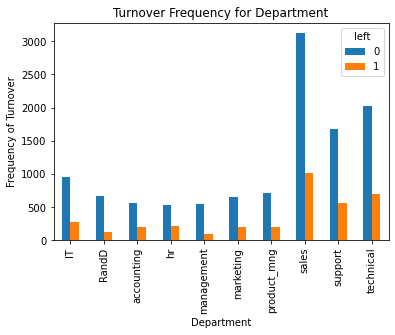

In [181]:
%matplotlib inline
import matplotlib.pyplot as plt
pd.crosstab(hr_data.dept,hr_data.left).plot(kind='bar')
plt.title('Turnover Frequency for Department')
plt.xlabel('Department')
plt.ylabel('Frequency of Turnover')
plt.savefig('department_bar_chart')

In [182]:
pd.crosstab(hr_data.dept, hr_data.left)

left,0,1
dept,,
IT,954,273
RandD,666,121
accounting,563,204
hr,524,215
management,539,91
marketing,655,203
product_mng,704,198
sales,3126,1014
support,1674,555


In [183]:
import numpy as np
corr_matrix=hr_leftdata.corr()
corr_matrix

,satisfactoryLevel,lastEvaluation,numberOfProjects,avgMonthlyHours,timeSpent.company,workAccident,left,promotionInLast5years
satisfactoryLevel,1.000000,0.182295,-0.227113,-0.084117,0.446440,0.005864,NaN,0.005516
lastEvaluation,0.182295,1.000000,0.804155,0.830336,0.783873,-0.001875,NaN,-0.047992
numberOfProjects,-0.227113,0.804155,1.000000,0.875194,0.601989,-0.008401,NaN,-0.032301
avgMonthlyHours,-0.084117,0.830336,0.875194,1.000000,0.664011,-0.009048,NaN,-0.035475
timeSpent.company,0.446440,0.783873,0.601989,0.664011,1.000000,0.005222,NaN,-0.045888
workAccident,0.005864,-0.001875,-0.008401,-0.009048,0.005222,1.000000,NaN,0.056214
left,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
promotionInLast5years,0.005516,-0.047992,-0.032301,-0.035475,-0.045888,0.056214,NaN,1.000000


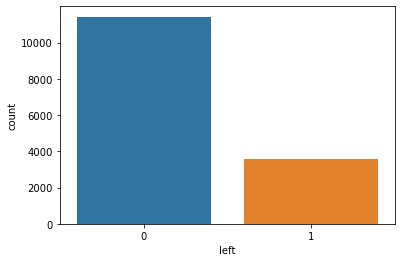

In [4]:
sns.countplot(hr_data['left'])

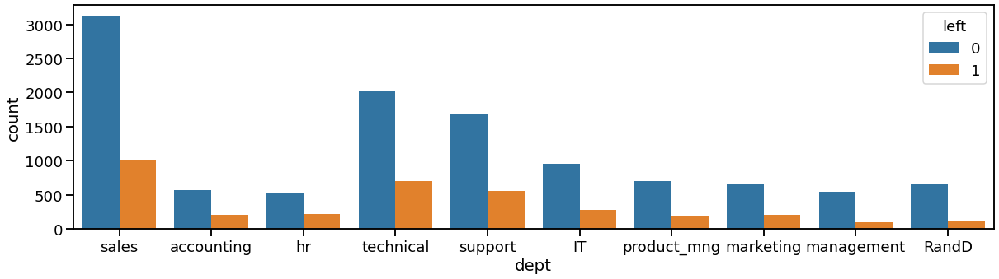

In [42]:
plt.figure(figsize=(20,5))
sns.countplot(x='dept',hue='left',data=hr_data)

In [ ]:
plt.figure(figsize=(20,5))
sns.countplot(x='dept',hue='left',data=hr_data)

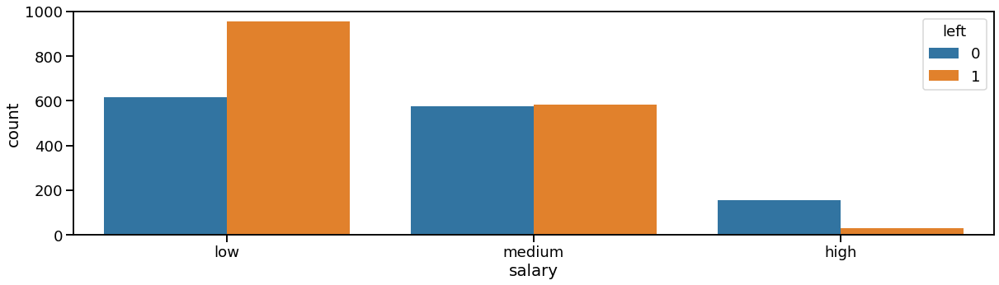

In [34]:
plt.figure(figsize=(20,5))
sns.countplot(x='salary',hue='left',data=hr_leastsatis)

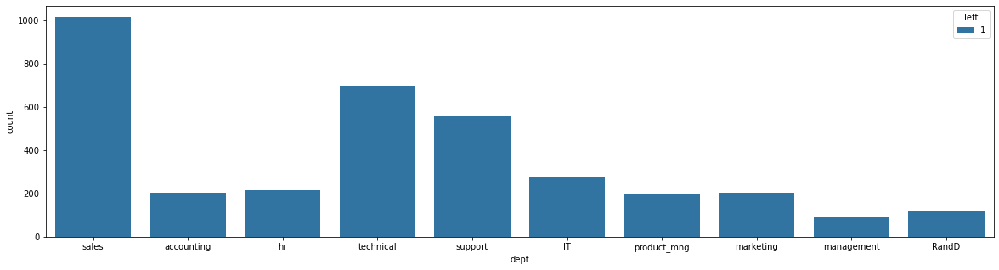

In [185]:
plt.figure(figsize=(20,5))
sns.countplot(x='dept',hue='left',data=hr_leftdata)

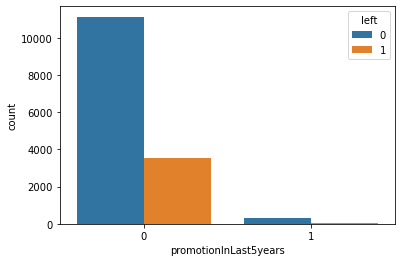

In [26]:
sns.countplot(x='promotionInLast5years',hue='left',data=hr_data)

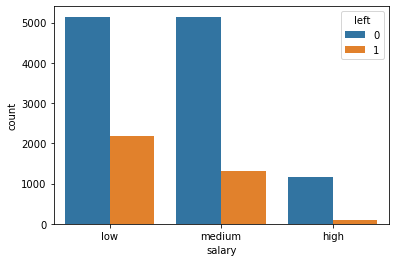

In [28]:
sns.countplot(x='salary',hue='left',data=hr_data)

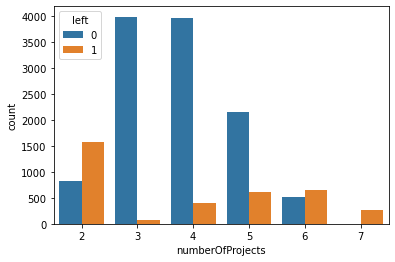

In [29]:
sns.countplot(x='numberOfProjects',hue='left',data=hr_data)

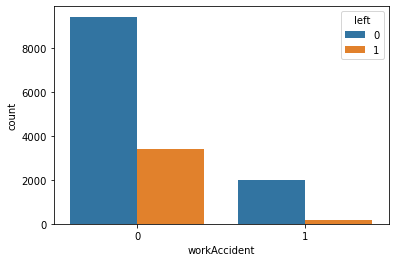

In [30]:
sns.countplot(x='workAccident',hue='left',data=hr_data)

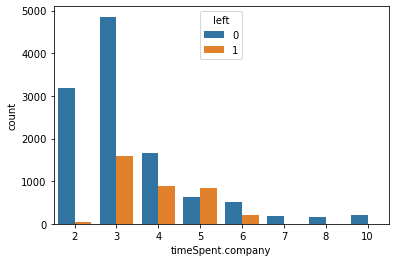

In [186]:
sns.countplot(x='timeSpent.company',hue='left',data=hr_data)

C:\Anaconda\lib\site-packages\seaborn\distributions.py:369: UserWarning: Default bandwidth for data is 0; skipping density estimation.
  warnings.warn(msg, UserWarning)


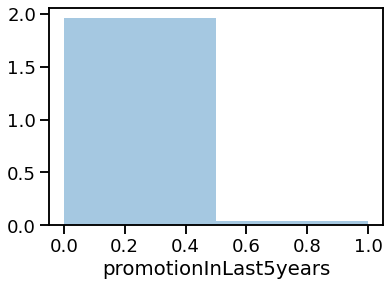

In [56]:
sns.distplot(hr_data['promotionInLast5years'],bins=2,kde=True)

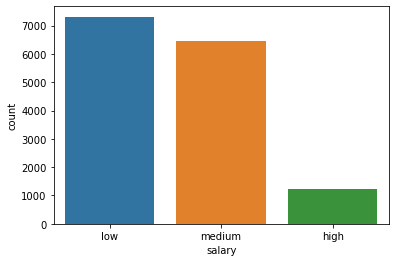

In [37]:
sns.countplot(hr_data['salary'])

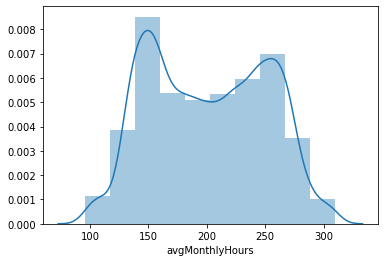

In [38]:
sns.distplot(hr_data['avgMonthlyHours'],bins=10,kde=True)

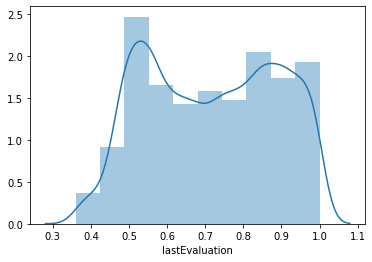

In [39]:
sns.distplot(hr_data['lastEvaluation'],bins=10,kde=True)

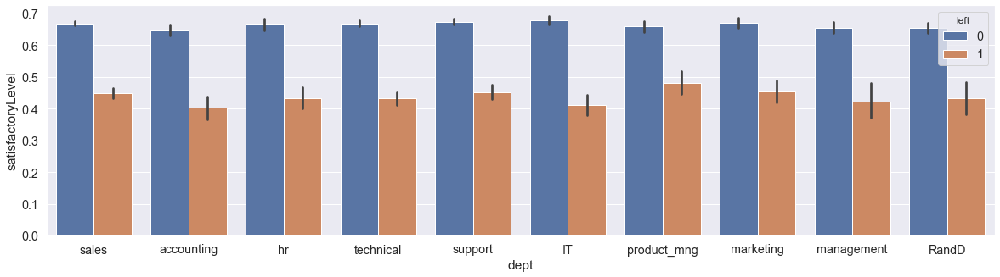

In [46]:
sns.set(font_scale=1.3)
plt.figure(figsize=(20,5))
sns.barplot(x='dept',y='satisfactoryLevel',hue='left',data=hr_data)

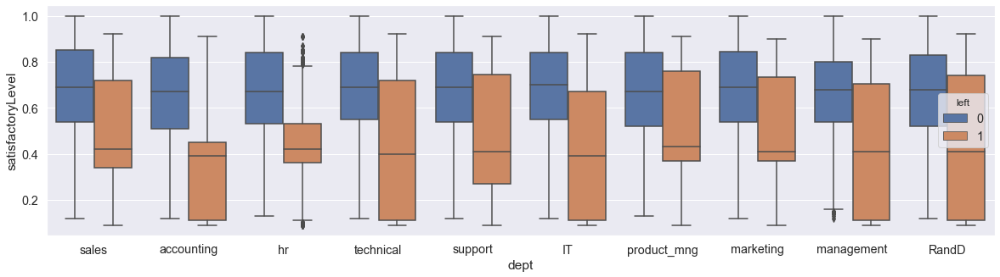

In [44]:
sns.set(font_scale=1.3)
plt.figure(figsize=(20,5))
sns.boxplot(x='dept',y='satisfactoryLevel',hue='left',data=hr_data)

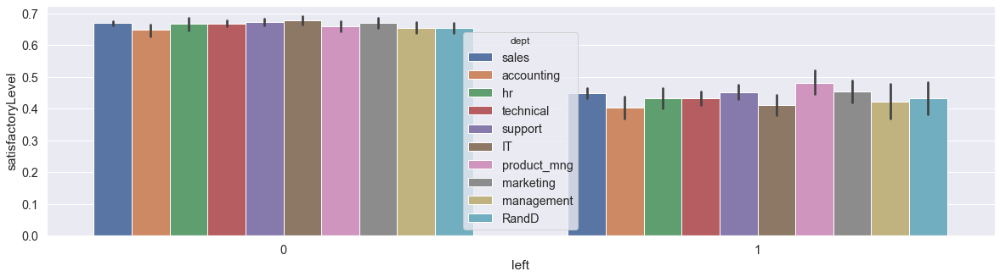

In [49]:
plt.figure(figsize=(20,5))
sns.barplot(x='left',y='satisfactoryLevel',hue='dept',data=hr_data)

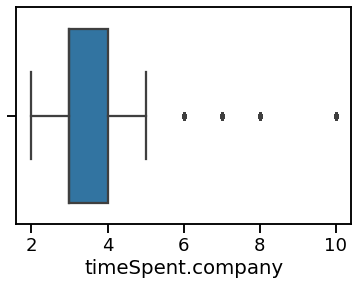

In [38]:
sns.boxplot(x='timeSpent.company',hue='left',data=hr_data)

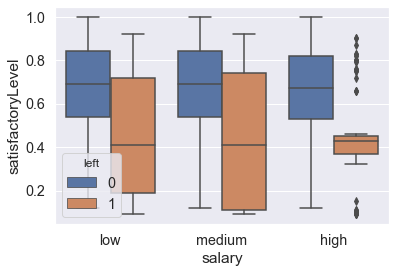

In [46]:
sns.boxplot(x='salary',y='satisfactoryLevel',hue='left',data=hr_data)

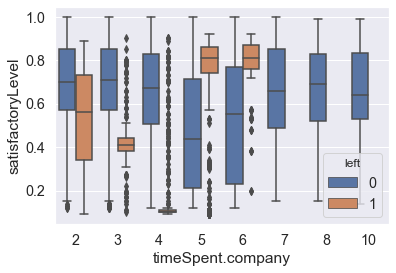

In [47]:
sns.boxplot(x='timeSpent.company',y='satisfactoryLevel',hue='left',data=hr_data)

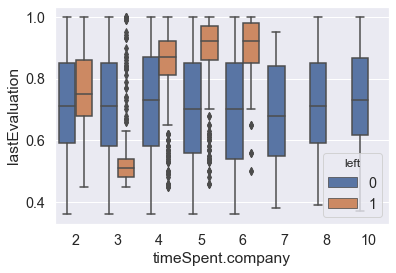

In [55]:
sns.boxplot(x='timeSpent.company',y='lastEvaluation',hue='left',data=hr_data)

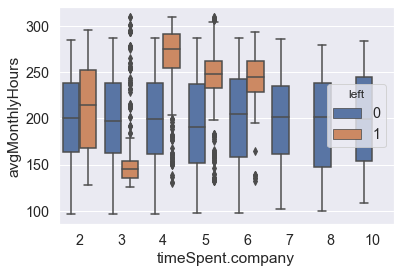

In [56]:
sns.boxplot(x='timeSpent.company',y='avgMonthlyHours',hue='left',data=hr_data)

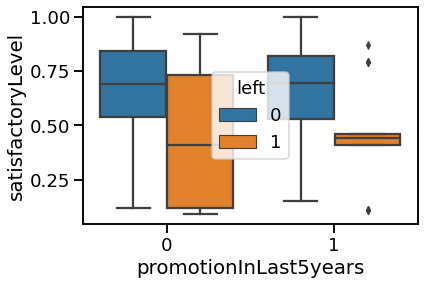

In [33]:
sns.boxplot(x='promotionInLast5years',y='satisfactoryLevel',hue='left',data=hr_data)

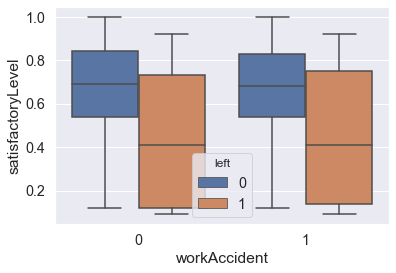

In [49]:
sns.boxplot(x='workAccident',y='satisfactoryLevel',hue='left',data=hr_data)

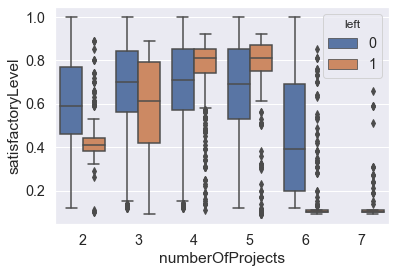

In [50]:
sns.boxplot(x='numberOfProjects',y='satisfactoryLevel',hue='left',data=hr_data)

<Figure size 1440x360 with 0 Axes>

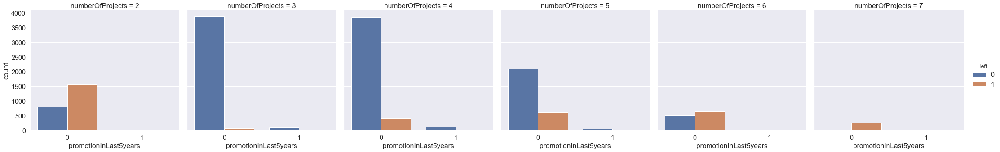

In [12]:
sns.set(font_scale=1.3)
plt.figure(figsize=(20,5))
sns.factorplot(x='promotionInLast5years',hue='left',col='numberOfProjects',data=hr_data,kind='count')

<Figure size 1440x360 with 0 Axes>

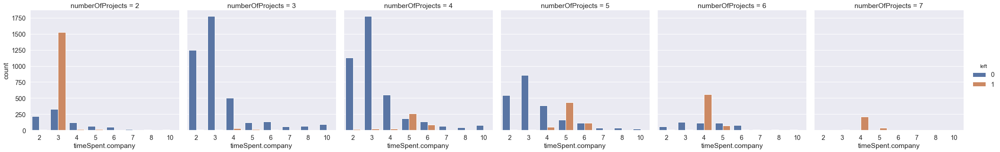

In [16]:
#Timespent relationships
sns.set(font_scale=1.3)
plt.figure(figsize=(20,5))
sns.factorplot(x='timeSpent.company',hue='left',col='numberOfProjects',data=hr_data,kind='count')

<Figure size 1440x360 with 0 Axes>

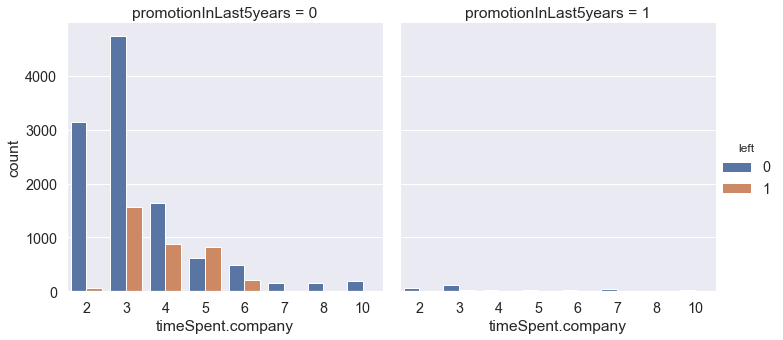

In [18]:
#Timespent relationships
sns.set(font_scale=1.3)
plt.figure(figsize=(20,5))
sns.factorplot(x='timeSpent.company',hue='left',col='promotionInLast5years',data=hr_data,kind='count')

<Figure size 1440x360 with 0 Axes>

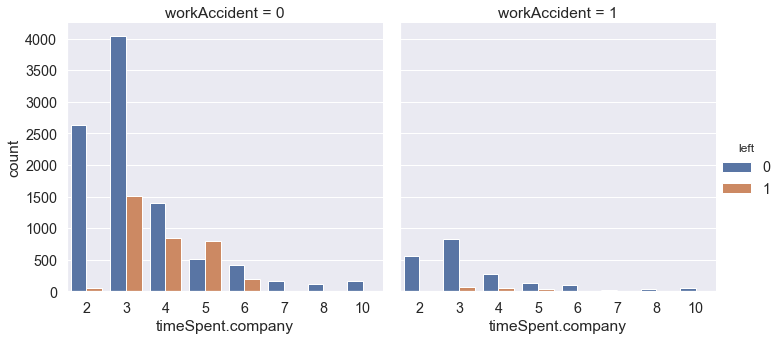

In [20]:
#Timespent relationships
sns.set(font_scale=1.3)
plt.figure(figsize=(20,5))
sns.factorplot(x='timeSpent.company',hue='left',col='workAccident',data=hr_data,kind='count')

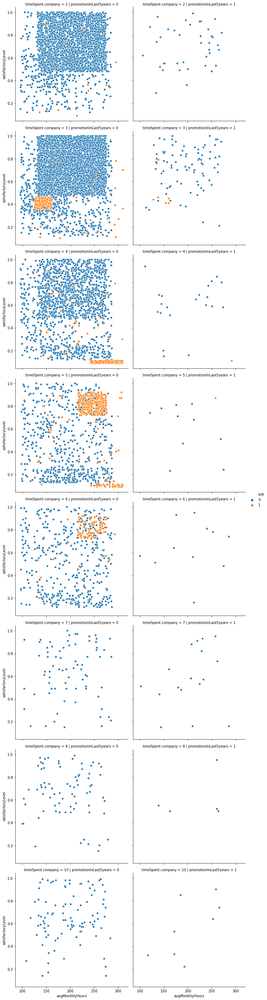

In [23]:
#Timespent relationships
sns.relplot(x='avgMonthlyHours',y='satisfactoryLevel',hue='left',data=hr_data,kind='scatter',row='timeSpent.company',col='promotionInLast5years')
plt.savefig('timespent_avgmonthhourssatis_promotioncomparison.png', dpi=150)

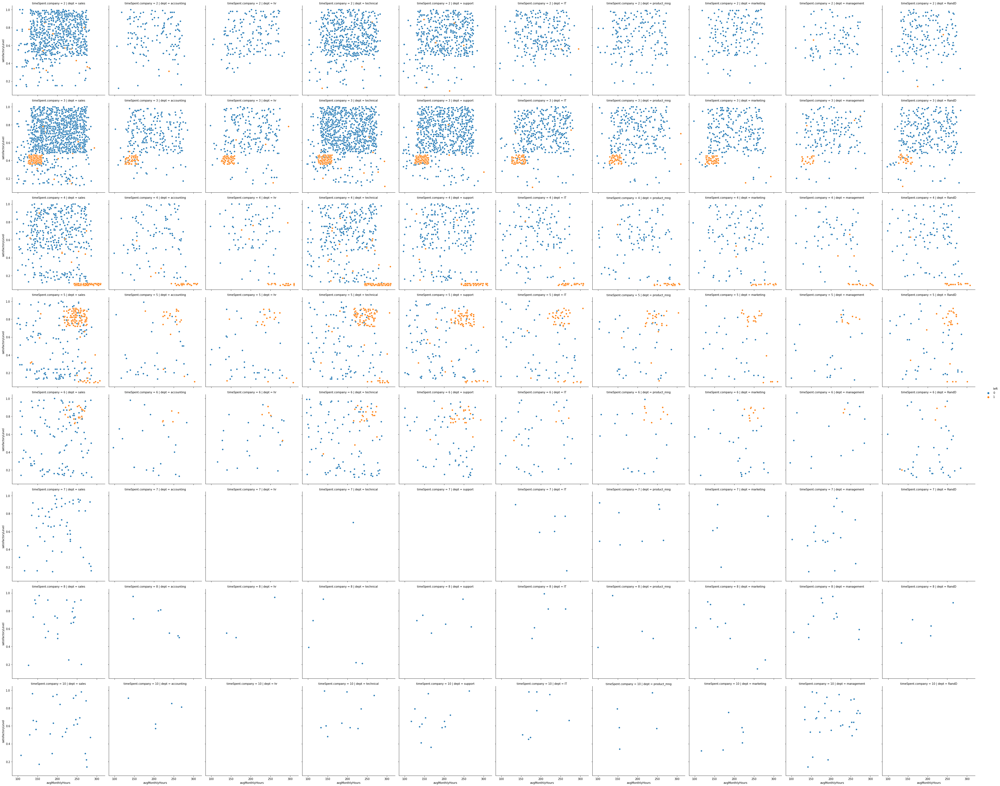

In [10]:
#Timespent relationships
sns.relplot(x='avgMonthlyHours',y='satisfactoryLevel',hue='left',data=hr_data,kind='scatter',row='timeSpent.company',col='dept')
plt.savefig('timespent_avgmonthhourssatis_deptwisecomparison.png', dpi=150)

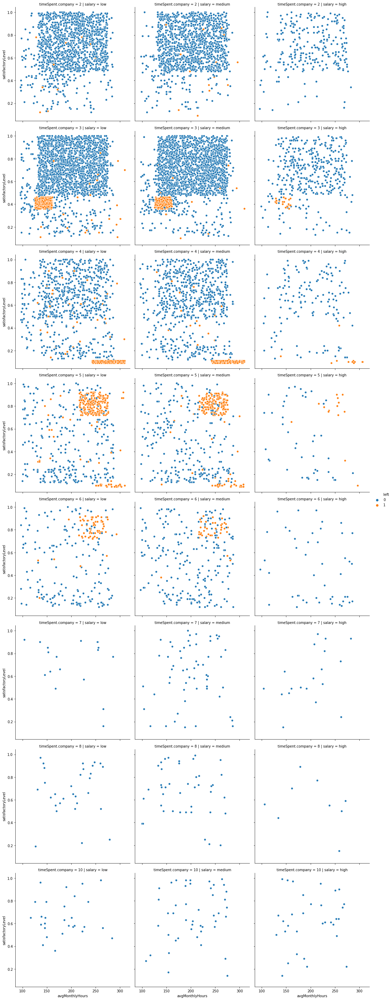

In [13]:
#Timespent relationships
sns.relplot(x='avgMonthlyHours',y='satisfactoryLevel',hue='left',data=hr_data,kind='scatter',row='timeSpent.company',col='salary')
plt.savefig('timespent_avgmonthhourssatis_salarywisecomparison.png', dpi=150)

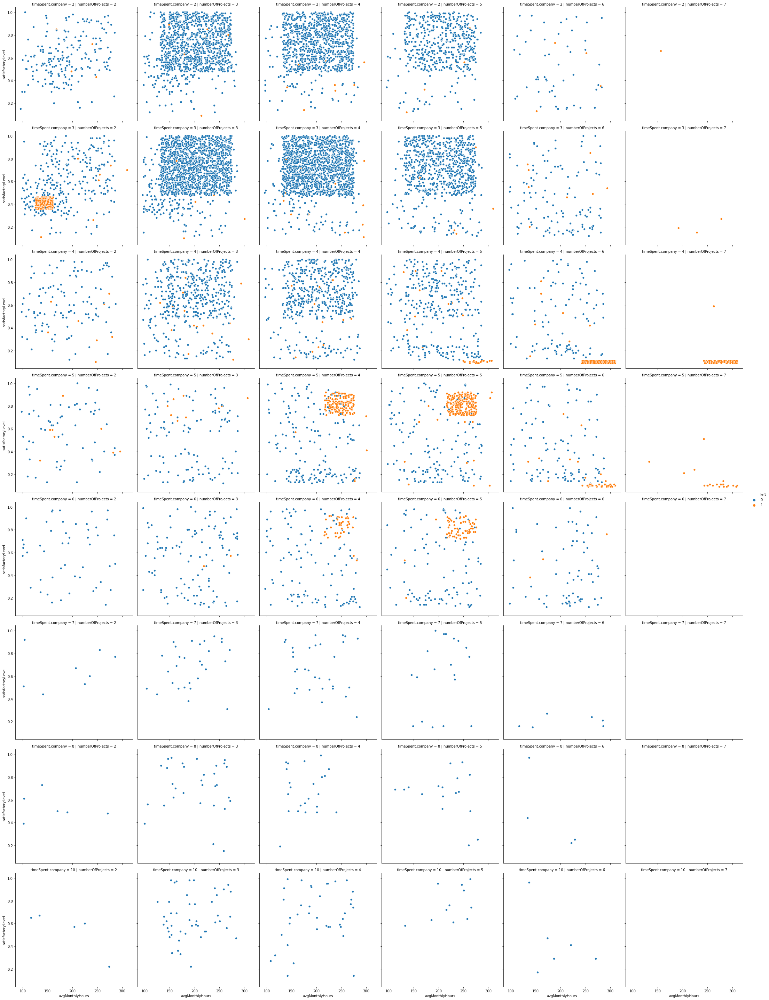

In [22]:
#Timespent relationships
sns.relplot(x='avgMonthlyHours',y='satisfactoryLevel',hue='left',data=hr_data,kind='scatter',row='timeSpent.company',col='numberOfProjects')
plt.savefig('timespent_avgmonthhourssatis_noofprojswisecomparison.png', dpi=150)

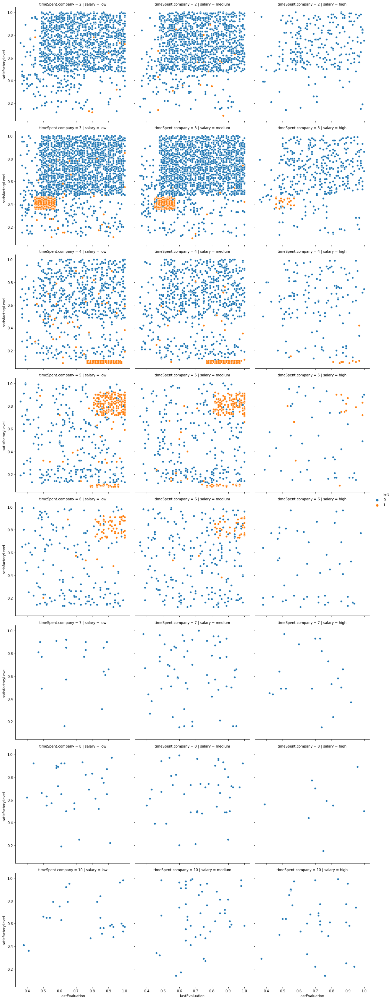

In [14]:
#Timespent relationships
sns.relplot(x='lastEvaluation',y='satisfactoryLevel',hue='left',data=hr_data,kind='scatter',row='timeSpent.company',col='salary')
plt.savefig('timespent_lastEvalsatis_salarywisecomparison.png', dpi=150)

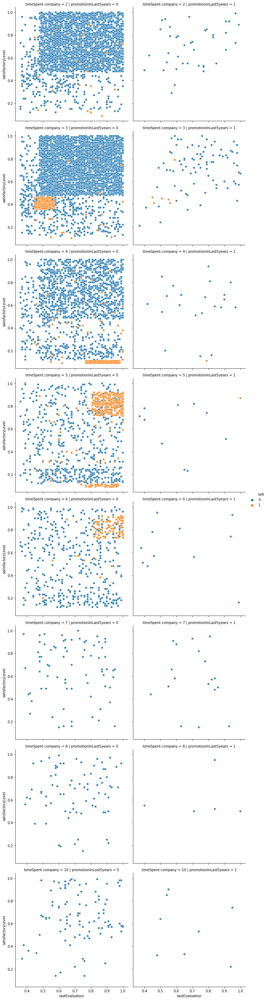

In [15]:
#Timespent relationships
sns.relplot(x='lastEvaluation',y='satisfactoryLevel',hue='left',data=hr_data,kind='scatter',row='timeSpent.company',col='promotionInLast5years')
plt.savefig('timespent_lastEvalsatis_promotionwisecomparison.png', dpi=150)

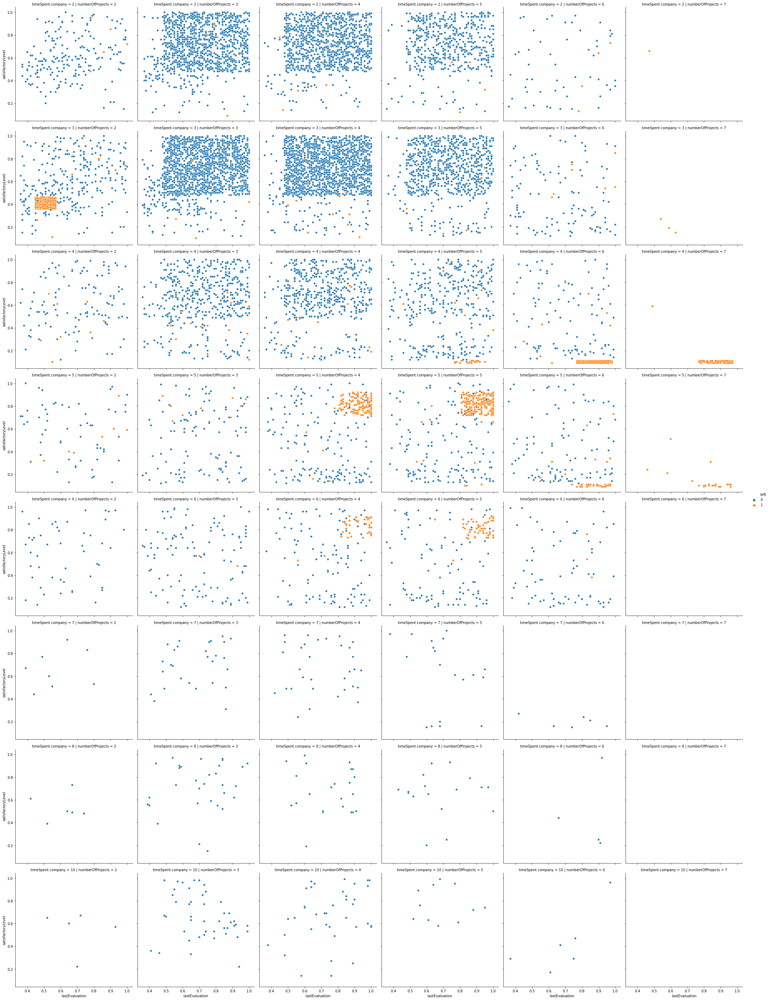

In [16]:
#Timespent relationships
sns.relplot(x='lastEvaluation',y='satisfactoryLevel',hue='left',data=hr_data,kind='scatter',row='timeSpent.company',col='numberOfProjects')
plt.savefig('timespent_lastEvalsatis_noofprojswisecomparison.png', dpi=150)

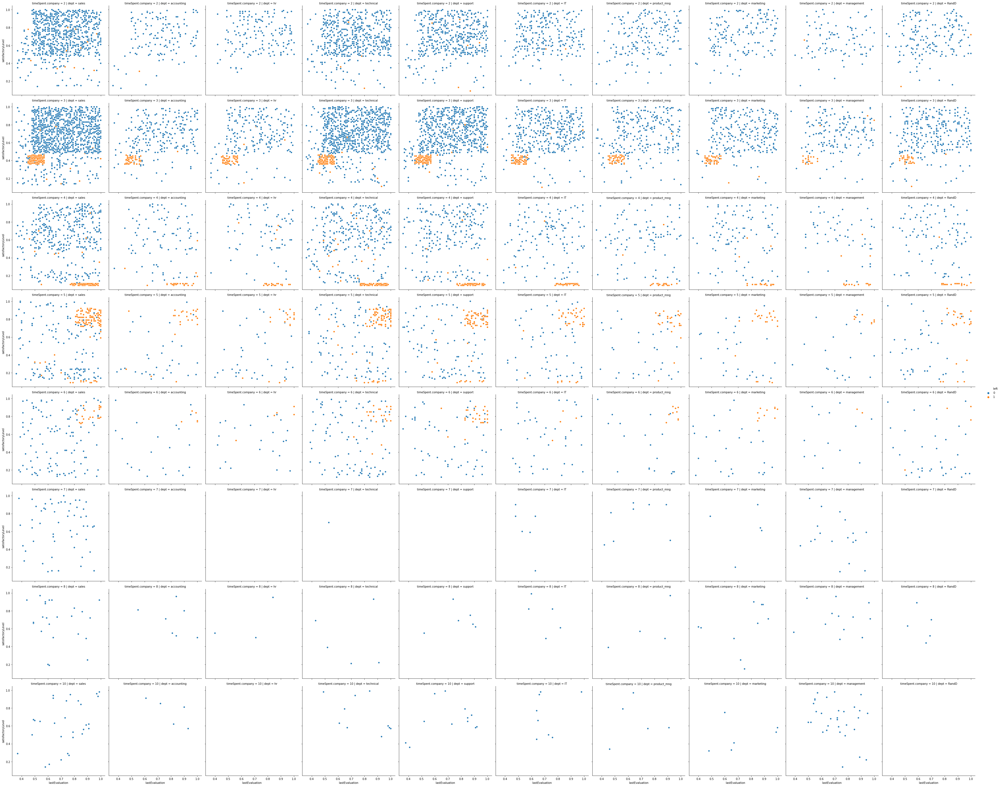

In [21]:
#Timespent relationships
sns.relplot(x='lastEvaluation',y='satisfactoryLevel',hue='left',data=hr_data,kind='scatter',row='timeSpent.company',col='dept')
plt.savefig('timespent_lastEvalsatis_deptwisecomparison.png', dpi=150)

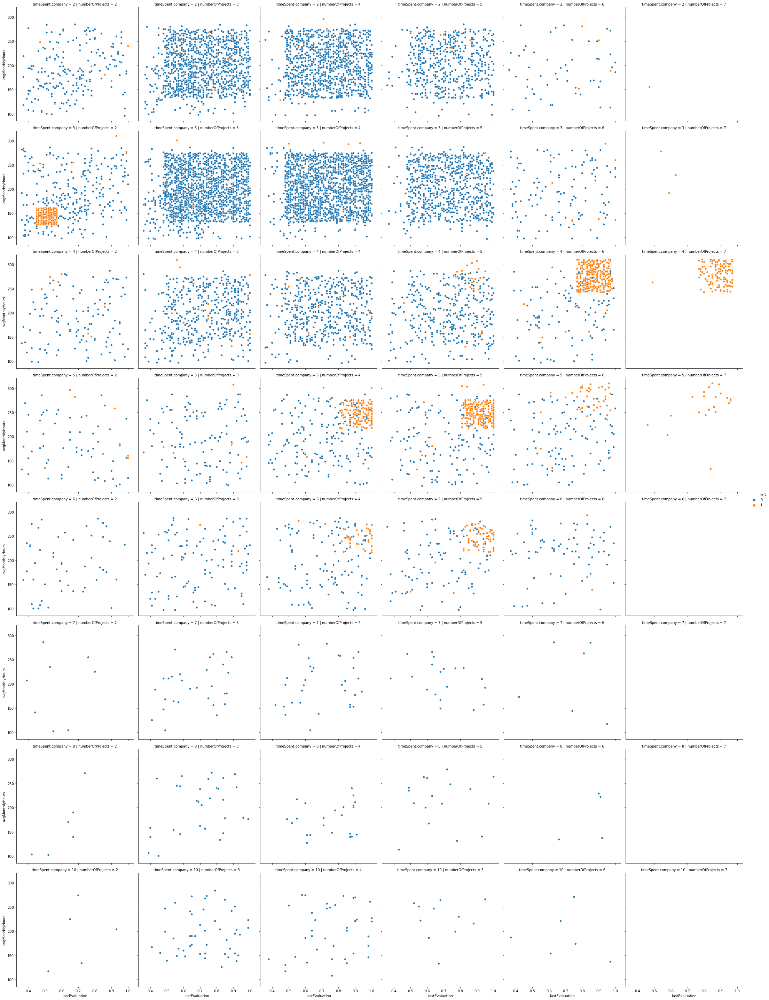

In [17]:
#Timespent relationships
sns.relplot(x='lastEvaluation',y='avgMonthlyHours',hue='left',data=hr_data,kind='scatter',row='timeSpent.company',col='numberOfProjects')
plt.savefig('timespent_lastEvalavgmonthlyhours_noofprojswisecomparison.png', dpi=150)

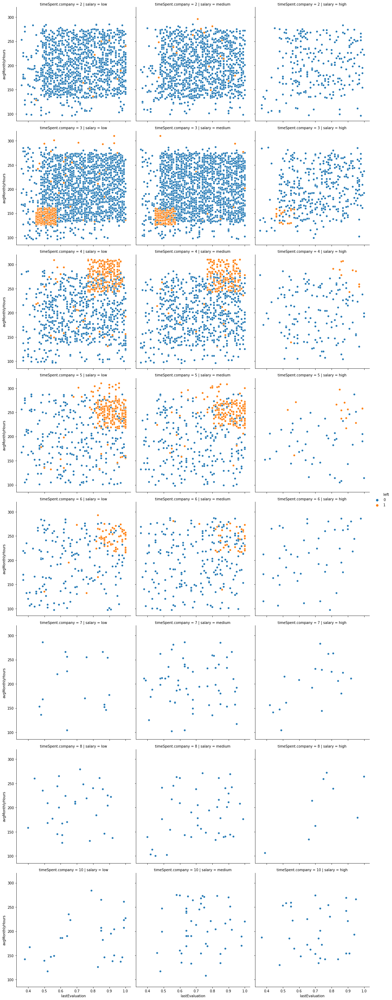

In [18]:
#Timespent relationships
sns.relplot(x='lastEvaluation',y='avgMonthlyHours',hue='left',data=hr_data,kind='scatter',row='timeSpent.company',col='salary')
plt.savefig('timespent_lastEvalavgmonthlyhours_salarywisecomparison.png', dpi=150)

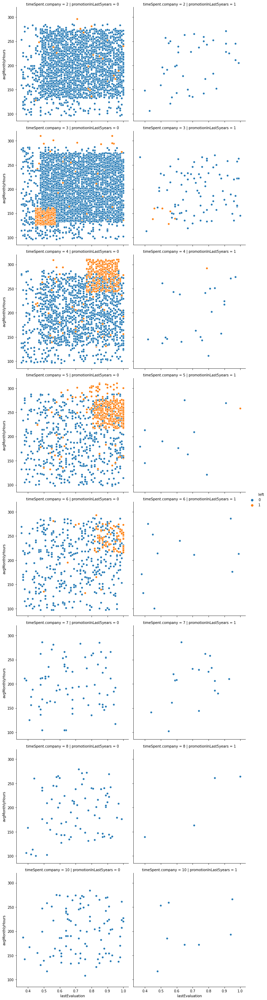

In [19]:
#Timespent relationships
sns.relplot(x='lastEvaluation',y='avgMonthlyHours',hue='left',data=hr_data,kind='scatter',row='timeSpent.company',col='promotionInLast5years')
plt.savefig('timespent_lastEvalavgmonthlyhours_promotioninlast5yrswisecomparison.png', dpi=150)

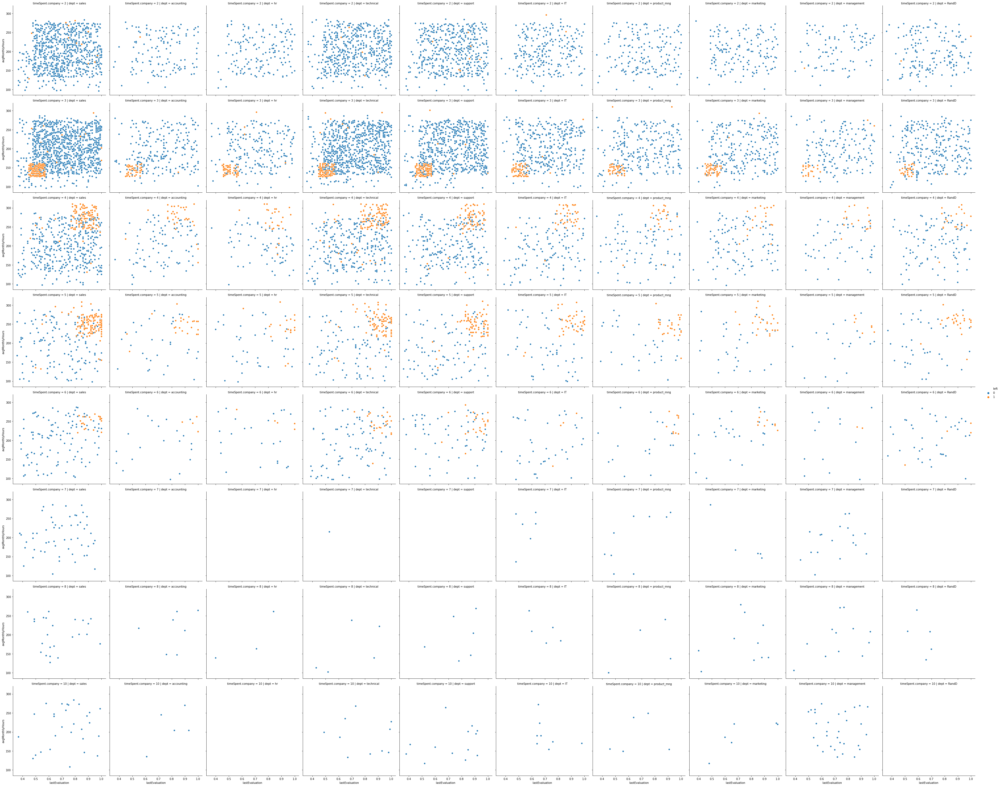

In [20]:
#Timespent relationships
sns.relplot(x='lastEvaluation',y='avgMonthlyHours',hue='left',data=hr_data,kind='scatter',row='timeSpent.company',col='dept')
plt.savefig('timespent_lastEvalavgmonthlyhours_deptwisecomparison.png', dpi=150)

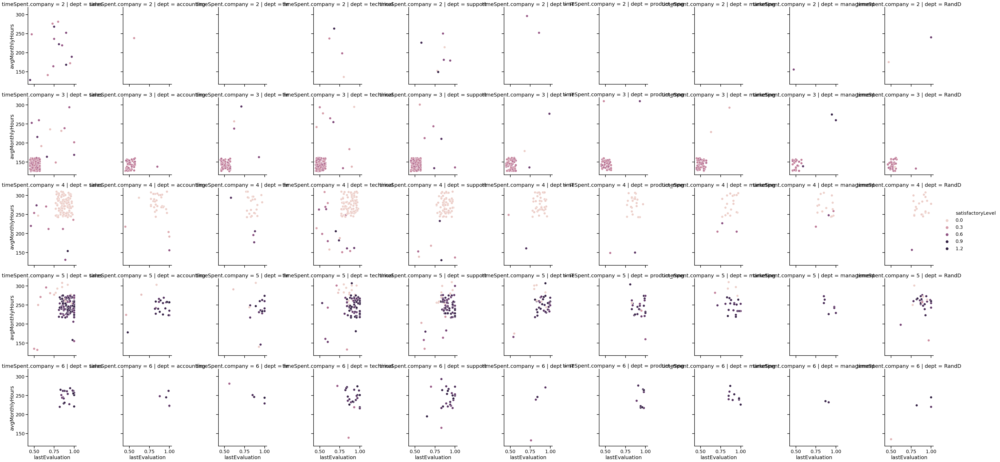

In [42]:
#Timespent relationships
sns.relplot(x='lastEvaluation',y='avgMonthlyHours',hue='satisfactoryLevel',data=hr_leftdata,kind='scatter',row='timeSpent.company',col='dept')
plt.savefig('timespent_lastEvalavgmonthlyhours_deptwisesatisfcomparison.png', dpi=150)

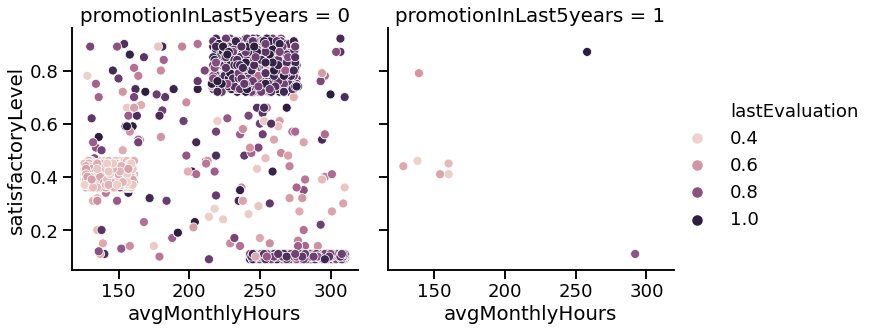

In [37]:
#Timespent relationships
sns.relplot(x='avgMonthlyHours',y='satisfactoryLevel',hue='lastEvaluation',data=hr_leftdata,kind='scatter',col='promotionInLast5years')
plt.savefig('timespent_.png', dpi=150)

<Figure size 1440x360 with 0 Axes>

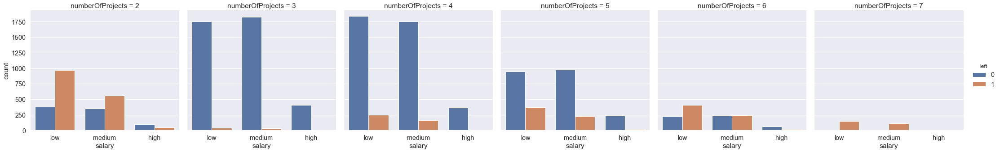

In [15]:
sns.set(font_scale=1.3)
plt.figure(figsize=(20,5))
sns.factorplot(x='salary',hue='left',col='numberOfProjects',data=hr_data,kind='count')

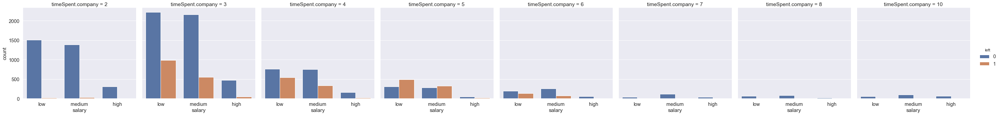

In [59]:
sns.factorplot(x='salary',hue='left',col='timeSpent.company',data=hr_data,kind='count')

C:\Anaconda\lib\site-packages\seaborn\categorical.py:3666: UserWarning: The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.
  warnings.warn(msg)


<Figure size 1440x360 with 0 Axes>

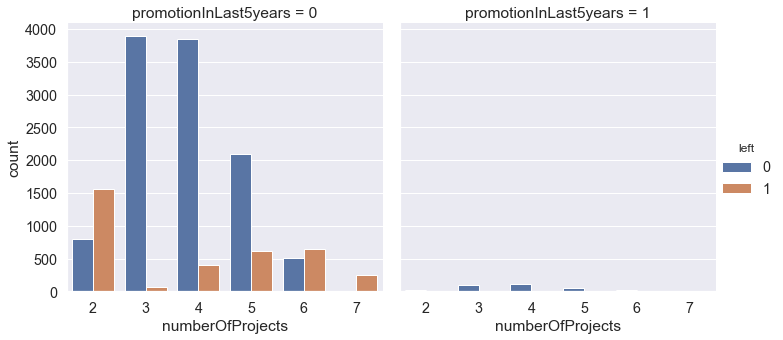

In [5]:
sns.set(font_scale=1.3)
plt.figure(figsize=(20,5))
sns.factorplot(x='numberOfProjects',hue='left',col='promotionInLast5years',data=hr_data,kind='count')


<Figure size 1440x360 with 0 Axes>

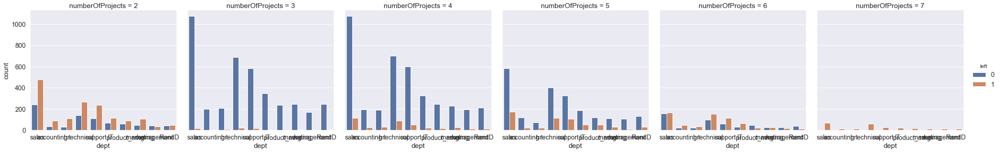

In [6]:
sns.set(font_scale=1.3)
plt.figure(figsize=(20,5))
sns.factorplot(x='dept',hue='left',col='numberOfProjects',data=hr_data,kind='count')


In [1]:
sns.factorplot(x='dept',hue='left',col='promotionInLast5years',data=hr_data,kind='count')


NameError: name 'sns' is not defined

<Figure size 1440x360 with 0 Axes>

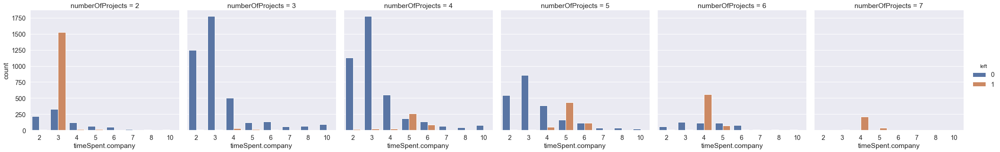

In [9]:
sns.set(font_scale=1.3)
plt.figure(figsize=(20,5))
sns.factorplot(x='timeSpent.company',hue='left',col='numberOfProjects',data=hr_data,kind='count')


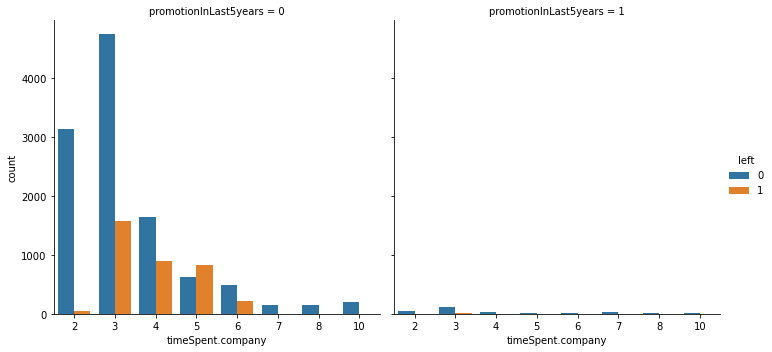

In [12]:
sns.factorplot(x='timeSpent.company',hue='left',col='promotionInLast5years',data=hr_data,kind='count')


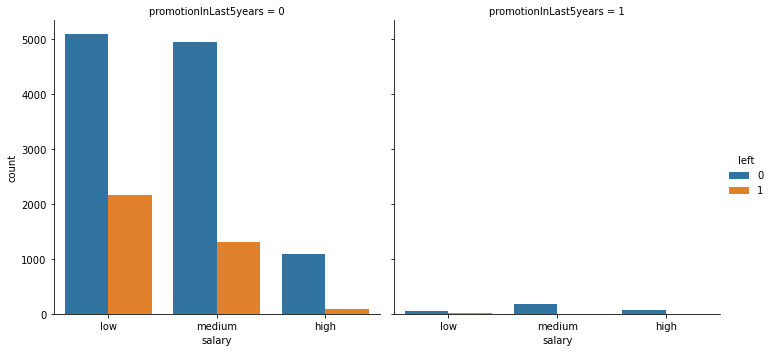

In [13]:
sns.factorplot(x='salary',hue='left',col='promotionInLast5years',data=hr_data,kind='count')


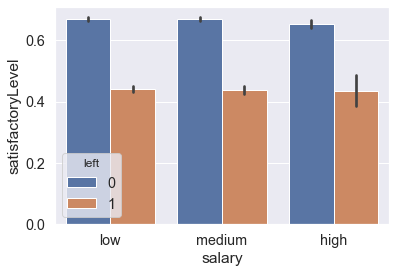

In [58]:
sns.barplot(x='salary',y='satisfactoryLevel',hue='left',data=hr_data)

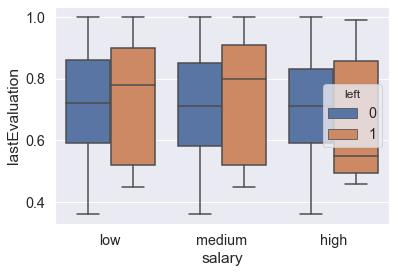

In [51]:
sns.boxplot(x='salary',y='lastEvaluation',hue='left',data=hr_data)

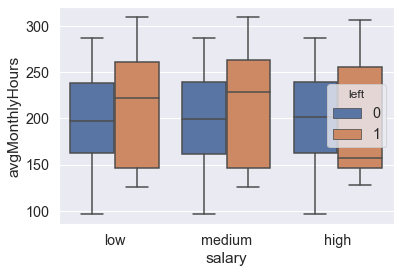

In [52]:
sns.boxplot(x='salary',y='avgMonthlyHours',hue='left',data=hr_data)

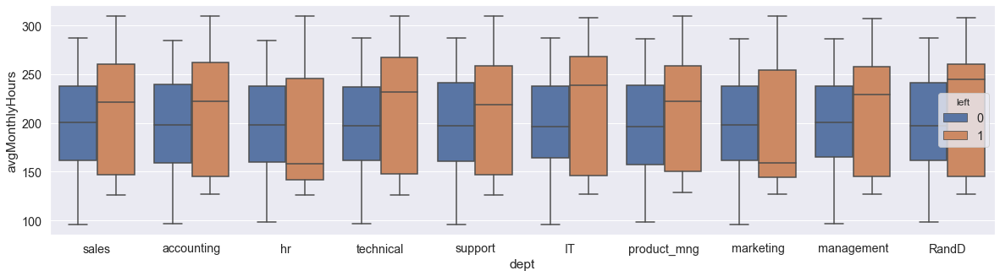

In [53]:
plt.figure(figsize=(20,5))
sns.boxplot(x='dept',y='avgMonthlyHours',hue='left',data=hr_data)

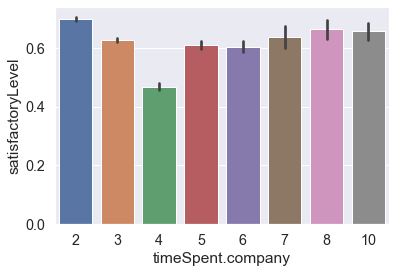

In [71]:
sns.barplot(x='timeSpent.company',y='satisfactoryLevel',data=hr_data)

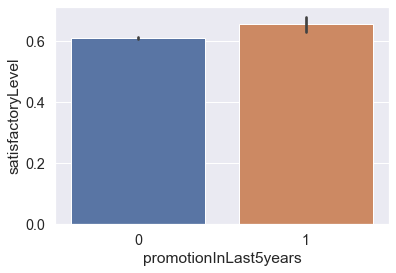

In [72]:
sns.barplot(x='promotionInLast5years',y='satisfactoryLevel',data=hr_data)

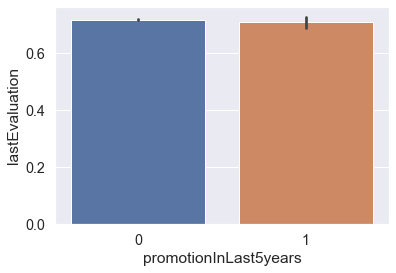

In [73]:
sns.barplot(x='promotionInLast5years',y='lastEvaluation',data=hr_data)

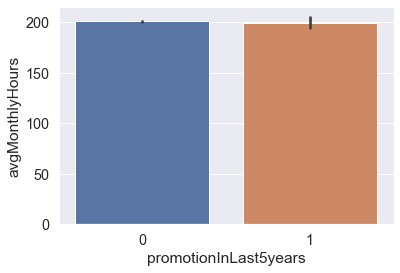

In [74]:
sns.barplot(x='promotionInLast5years',y='avgMonthlyHours',data=hr_data)

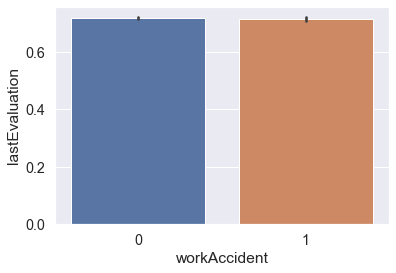

In [75]:
sns.barplot(x='workAccident',y='lastEvaluation',data=hr_data)

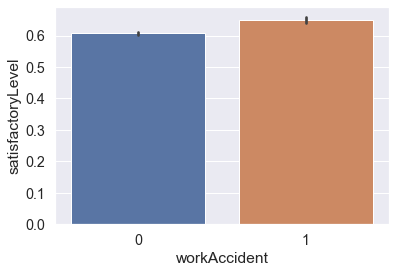

In [77]:
sns.barplot(x='workAccident',y='satisfactoryLevel',data=hr_data)

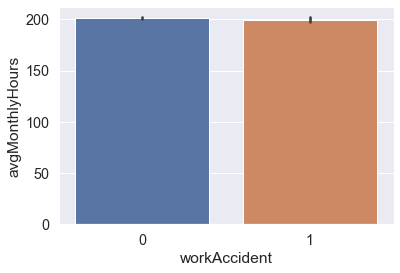

In [78]:
sns.barplot(x='workAccident',y='avgMonthlyHours',data=hr_data)

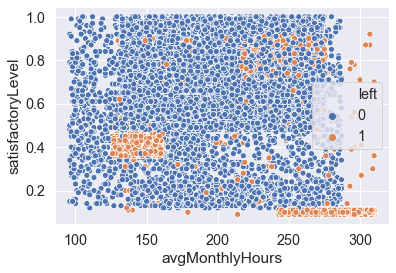

In [79]:
sns.scatterplot(x='avgMonthlyHours',y='satisfactoryLevel',hue='left',data=hr_data)

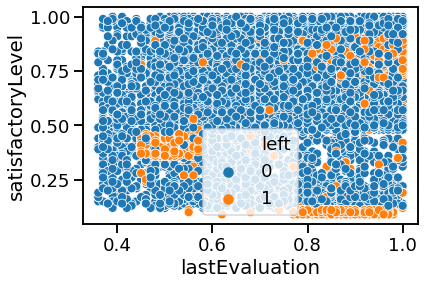

In [35]:
sns.scatterplot(x='lastEvaluation',y='satisfactoryLevel',hue='left',data=hr_data)

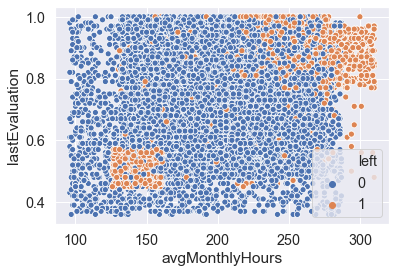

In [81]:
sns.scatterplot(x='avgMonthlyHours',y='lastEvaluation',hue='left',data=hr_data)

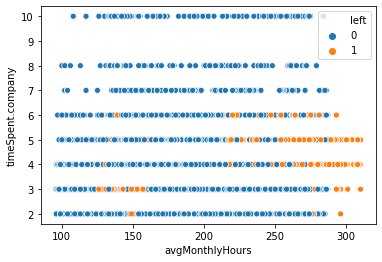

In [9]:
sns.scatterplot(x='avgMonthlyHours',y='timeSpent.company',hue='left',data=hr_data)

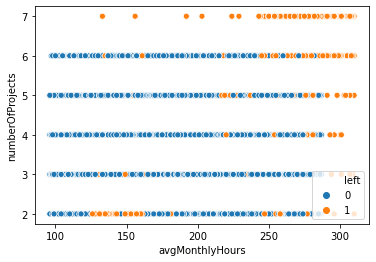

In [10]:
sns.scatterplot(x='avgMonthlyHours',y='numberOfProjects',hue='left',data=hr_data)

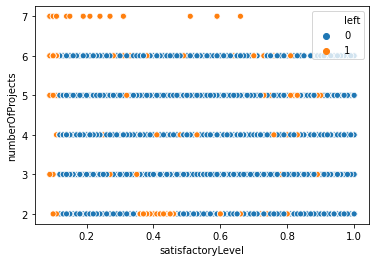

In [11]:
sns.scatterplot(x='satisfactoryLevel',y='numberOfProjects',hue='left',data=hr_data)

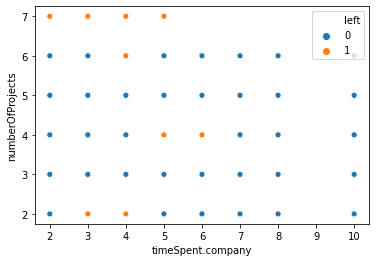

In [13]:
sns.scatterplot(x='timeSpent.company',y='numberOfProjects',hue='left',data=hr_data)

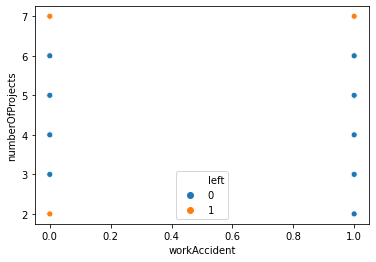

In [14]:
sns.scatterplot(x='workAccident',y='numberOfProjects',hue='left',data=hr_data)

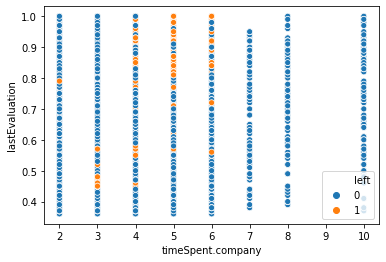

In [16]:
sns.scatterplot(x='timeSpent.company',y='lastEvaluation',hue='left',data=hr_data)

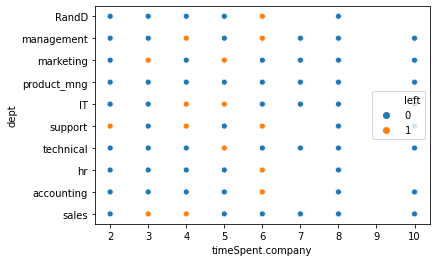

In [19]:
sns.scatterplot(x='timeSpent.company',y='dept',hue='left',data=hr_data)

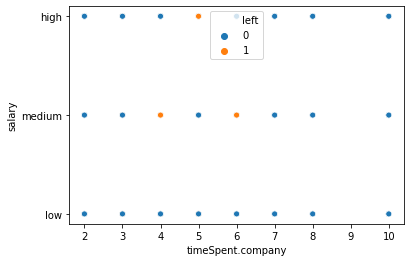

In [20]:
sns.scatterplot(x='timeSpent.company',y='salary',hue='left',data=hr_data)

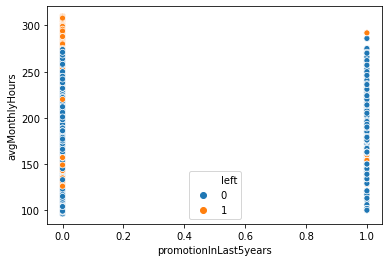

In [32]:
sns.scatterplot(x='promotionInLast5years',y='avgMonthlyHours',hue='left',data=hr_data)

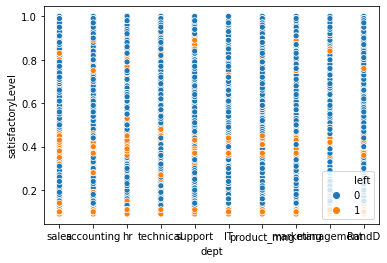

In [36]:
sns.scatterplot(x='dept',y='satisfactoryLevel',hue='left',data=hr_data)

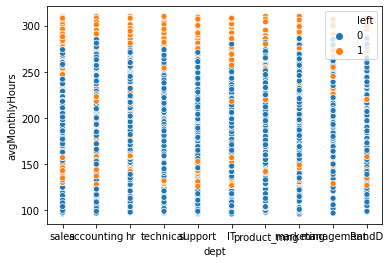

In [38]:
sns.scatterplot(x='dept',y='avgMonthlyHours',hue='left',data=hr_data)

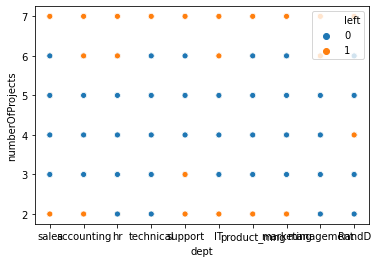

In [39]:
sns.scatterplot(x='dept',y='numberOfProjects',hue='left',data=hr_data)

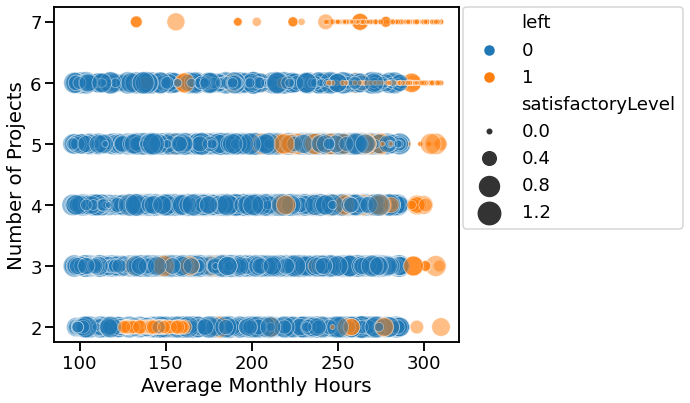

In [28]:
sns.set_context("talk", font_scale=1.1)
plt.figure(figsize=(10,6))
sns.scatterplot(x="avgMonthlyHours", 
                y="numberOfProjects",
                size="satisfactoryLevel",
                sizes=(20,500),
                alpha=0.5,
                hue="left",
                data=hr_data)
# Put the legend out of the figure
plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0)
# Put the legend out of the figure
#plt.legend(bbox_to_anchor=(1.01, 0.54),  borderaxespad=0.)
plt.xlabel("Average Monthly Hours")
plt.ylabel("Number of Projects")
#plt.title()
plt.tight_layout()
 
plt.savefig("Bubble_plot_Seaborn_color_by_variable_Seaborn_scatterplot.png",
                    format='png',dpi=150)

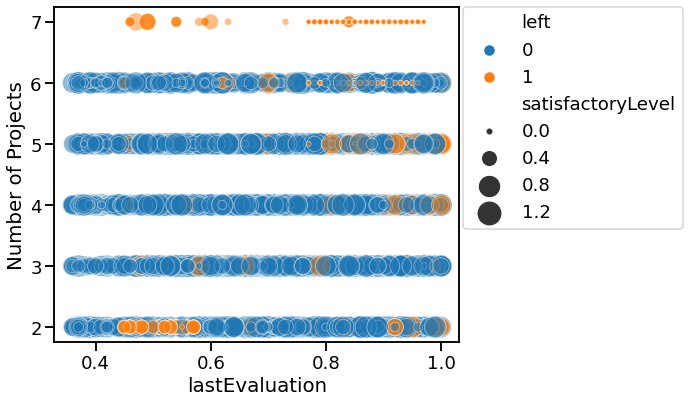

In [40]:
sns.set_context("talk", font_scale=1.1)
plt.figure(figsize=(10,6))
sns.scatterplot(x="lastEvaluation", 
                y="numberOfProjects",
                size="satisfactoryLevel",
                sizes=(20,500),
                alpha=0.5,
                hue="left",
                data=hr_data)
# Put the legend out of the figure
plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0)
# Put the legend out of the figure
#plt.legend(bbox_to_anchor=(1.01, 0.54),  borderaxespad=0.)
plt.xlabel("lastEvaluation")
plt.ylabel("Number of Projects")
#plt.title()
plt.tight_layout()
 
plt.savefig("Bubble_plot_Seaborn_color_by_variable_Seaborn_scatterplot.png",
                    format='png',dpi=150)

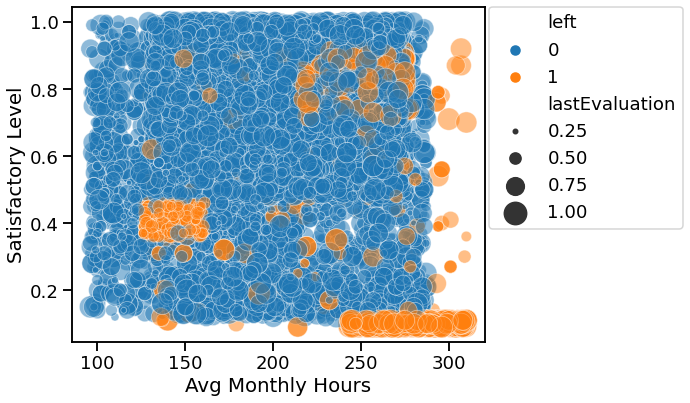

In [4]:
sns.set_context("talk", font_scale=1.1)
plt.figure(figsize=(10,6))
sns.scatterplot(x="avgMonthlyHours", 
                y="satisfactoryLevel",
                size="lastEvaluation",
                sizes=(20,500),
                alpha=0.5,
                hue="left",
                data=hr_data)
# Put the legend out of the figure
plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0)
# Put the legend out of the figure
#plt.legend(bbox_to_anchor=(1.01, 0.54),  borderaxespad=0.)
plt.xlabel("Avg Monthly Hours")
plt.ylabel("Satisfactory Level")
#plt.title()
plt.tight_layout()
 
plt.savefig("Bubble_plot_Seaborn_color_by_variable_Seaborn_scatterplot.png",
                    format='png',dpi=150)

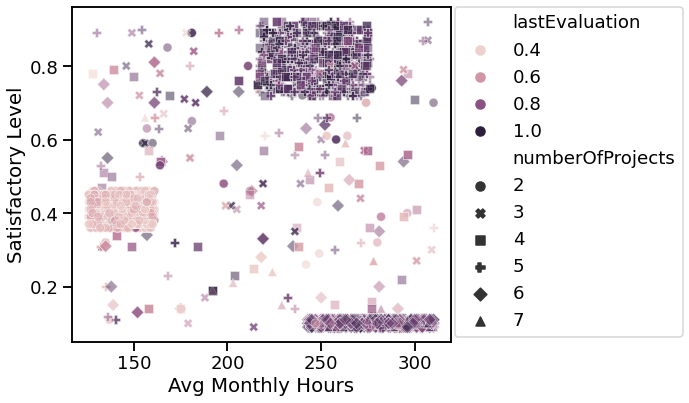

In [20]:
sns.set_context("talk", font_scale=1.1)
plt.figure(figsize=(10,6))
sns.scatterplot(x="avgMonthlyHours", 
                y="satisfactoryLevel",
                hue="lastEvaluation",
                sizes=(20,500),
                alpha=0.5,
                style="numberOfProjects",
                data=hr_leftdata)
# Put the legend out of the figure
plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0)
# Put the legend out of the figure
#plt.legend(bbox_to_anchor=(1.01, 0.54),  borderaxespad=0.)
plt.xlabel("Avg Monthly Hours")
plt.ylabel("Satisfactory Level")
#plt.title()
plt.tight_layout()
 
plt.savefig("Bubble_plot_left_wrtonumberofProjects_scatterplot.png",
                    format='png',dpi=150)

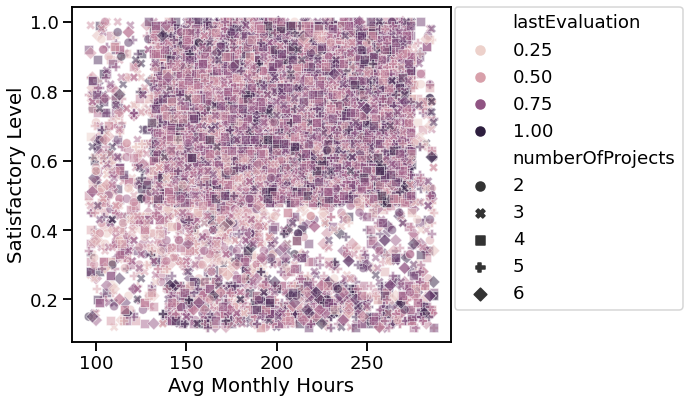

In [25]:
sns.set_context("talk", font_scale=1.1)
plt.figure(figsize=(10,6))
sns.scatterplot(x="avgMonthlyHours", 
                y="satisfactoryLevel",
                hue="lastEvaluation",
                sizes=(20,500),
                alpha=0.5,
                style="numberOfProjects",
                data=hr_staydata)
# Put the legend out of the figure
plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0)
# Put the legend out of the figure
#plt.legend(bbox_to_anchor=(1.01, 0.54),  borderaxespad=0.)
plt.xlabel("Avg Monthly Hours")
plt.ylabel("Satisfactory Level")
#plt.title()
plt.tight_layout()
 
plt.savefig("Bubble_plot_Seaborn_color_by_variable_Seaborn_scatterplot.png",
                    format='png',dpi=150)

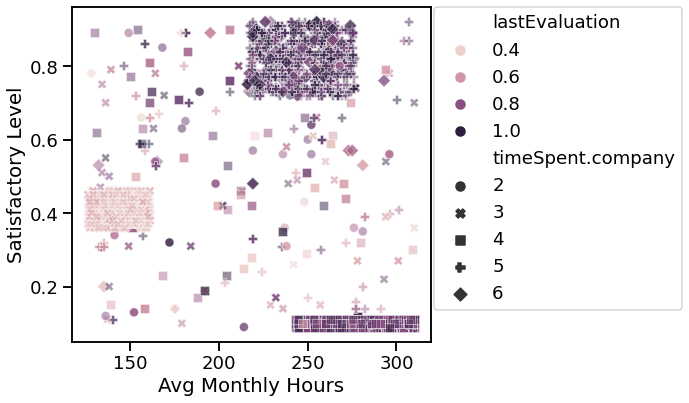

In [19]:
sns.set_context("talk", font_scale=1.1)
plt.figure(figsize=(10,6))
sns.scatterplot(x="avgMonthlyHours", 
                y="satisfactoryLevel",
                hue="lastEvaluation",
                sizes=(20,500),
                alpha=0.5,
                style="timeSpent.company",
                data=hr_leftdata)
# Put the legend out of the figure
plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0)
# Put the legend out of the figure
#plt.legend(bbox_to_anchor=(1.01, 0.54),  borderaxespad=0.)
plt.xlabel("Avg Monthly Hours")
plt.ylabel("Satisfactory Level")
#plt.title()
plt.tight_layout()
 
plt.savefig("Bubble_plot_timeSpent.company_scatterplot.png",
                    format='png',dpi=150)

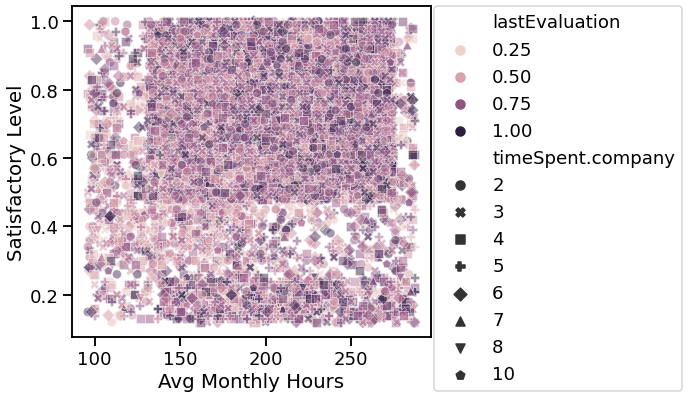

In [26]:
sns.set_context("talk", font_scale=1.1)
plt.figure(figsize=(10,6))
sns.scatterplot(x="avgMonthlyHours", 
                y="satisfactoryLevel",
                hue="lastEvaluation",
                sizes=(20,500),
                alpha=0.5,
                style="timeSpent.company",
                data=hr_staydata)
# Put the legend out of the figure
plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0)
# Put the legend out of the figure
#plt.legend(bbox_to_anchor=(1.01, 0.54),  borderaxespad=0.)
plt.xlabel("Avg Monthly Hours")
plt.ylabel("Satisfactory Level")
#plt.title()
plt.tight_layout()
 
plt.savefig("Bubble_plot_timeSpent.company_scatterplot.png",
                    format='png',dpi=150)

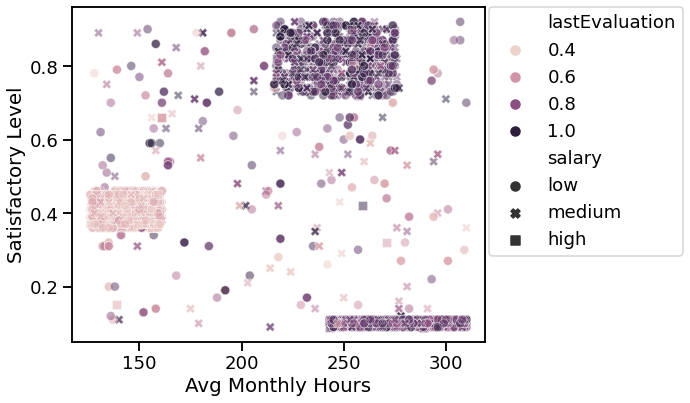

In [21]:
sns.set_context("talk", font_scale=1.1)
plt.figure(figsize=(10,6))
sns.scatterplot(x="avgMonthlyHours", 
                y="satisfactoryLevel",
                hue="lastEvaluation",
                sizes=(20,500),
                alpha=0.5,
                style="salary",
                data=hr_leftdata)
# Put the legend out of the figure
plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0)
# Put the legend out of the figure
#plt.legend(bbox_to_anchor=(1.01, 0.54),  borderaxespad=0.)
plt.xlabel("Avg Monthly Hours")
plt.ylabel("Satisfactory Level")
#plt.title()
plt.tight_layout()
 
plt.savefig("Bubble_plot_Seaborn_color_by_variable_Seaborn_scatterplot.png",
                    format='png',dpi=150)

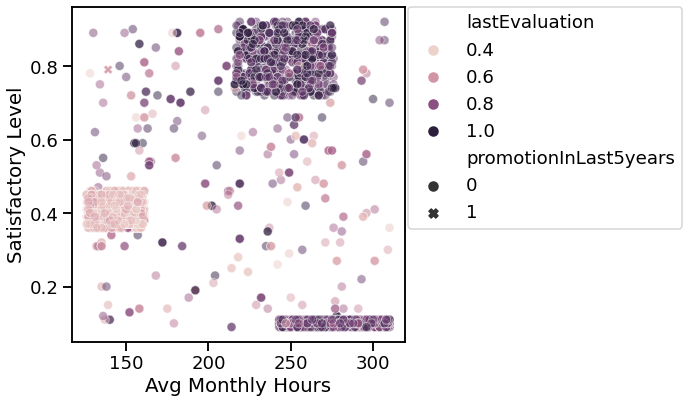

In [29]:
sns.set_context("talk", font_scale=1.1)
plt.figure(figsize=(10,6))
sns.scatterplot(x="avgMonthlyHours", 
                y="satisfactoryLevel",
                hue="lastEvaluation",
                sizes=(20,500),
                alpha=0.5,
                style="promotionInLast5years",
                data=hr_leftdata)
# Put the legend out of the figure
plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0)
# Put the legend out of the figure
#plt.legend(bbox_to_anchor=(1.01, 0.54),  borderaxespad=0.)
plt.xlabel("Avg Monthly Hours")
plt.ylabel("Satisfactory Level")
#plt.title()
plt.tight_layout()
 
plt.savefig("Bubble_plot_Seaborn_color_by_variable_Seaborn_scatterplot.png",
                    format='png',dpi=150)

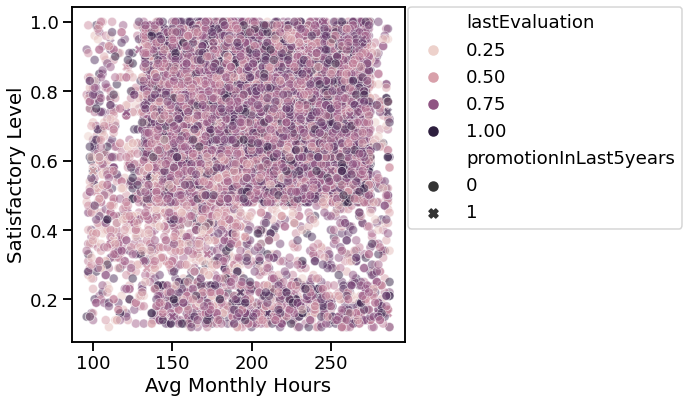

In [30]:
sns.set_context("talk", font_scale=1.1)
plt.figure(figsize=(10,6))
sns.scatterplot(x="avgMonthlyHours", 
                y="satisfactoryLevel",
                hue="lastEvaluation",
                sizes=(20,500),
                alpha=0.5,
                style="promotionInLast5years",
                data=hr_staydata)
# Put the legend out of the figure
plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0)
# Put the legend out of the figure
#plt.legend(bbox_to_anchor=(1.01, 0.54),  borderaxespad=0.)
plt.xlabel("Avg Monthly Hours")
plt.ylabel("Satisfactory Level")
#plt.title()
plt.tight_layout()
 
plt.savefig("Bubble_plot_Seaborn_color_by_variable_Seaborn_scatterplot.png",
                    format='png',dpi=150)

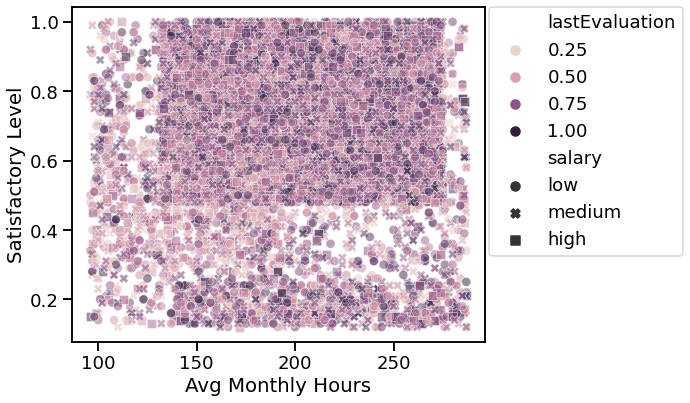

In [27]:
sns.set_context("talk", font_scale=1.1)
plt.figure(figsize=(10,6))
sns.scatterplot(x="avgMonthlyHours", 
                y="satisfactoryLevel",
                hue="lastEvaluation",
                sizes=(20,500),
                alpha=0.5,
                style="salary",
                data=hr_staydata)
# Put the legend out of the figure
plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0)
# Put the legend out of the figure
#plt.legend(bbox_to_anchor=(1.01, 0.54),  borderaxespad=0.)
plt.xlabel("Avg Monthly Hours")
plt.ylabel("Satisfactory Level")
#plt.title()
plt.tight_layout()
 
plt.savefig("Bubble_plot_Seaborn_color_by_variable_Seaborn_scatterplot.png",
                    format='png',dpi=150)

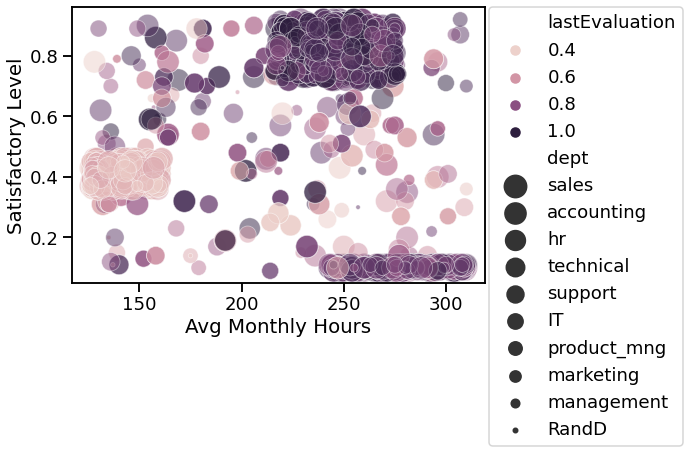

In [23]:
sns.set_context("talk", font_scale=1.1)
plt.figure(figsize=(10,6))
sns.scatterplot(x="avgMonthlyHours", 
                y="satisfactoryLevel",
                hue="lastEvaluation",
                sizes=(20,500),
                alpha=0.5,
                size="dept",
                data=hr_leftdata)
# Put the legend out of the figure
plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0)
# Put the legend out of the figure
#plt.legend(bbox_to_anchor=(1.01, 0.54),  borderaxespad=0.)
plt.xlabel("Avg Monthly Hours")
plt.ylabel("Satisfactory Level")
#plt.title()
plt.tight_layout()
 
plt.savefig("Bubble_plot_Seaborn_color_by_variable_Seaborn_scatterplot.png",
                    format='png',dpi=150)

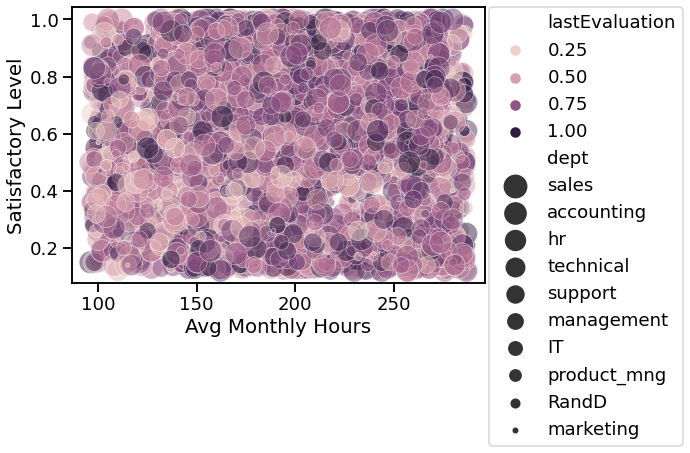

In [28]:
sns.set_context("talk", font_scale=1.1)
plt.figure(figsize=(10,6))
sns.scatterplot(x="avgMonthlyHours", 
                y="satisfactoryLevel",
                hue="lastEvaluation",
                sizes=(20,500),
                alpha=0.5,
                size="dept",
                data=hr_staydata)
# Put the legend out of the figure
plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0)
# Put the legend out of the figure
#plt.legend(bbox_to_anchor=(1.01, 0.54),  borderaxespad=0.)
plt.xlabel("Avg Monthly Hours")
plt.ylabel("Satisfactory Level")
#plt.title()
plt.tight_layout()
 
plt.savefig("Bubble_plot_Seaborn_color_by_variable_Seaborn_scatterplot.png",
                    format='png',dpi=150)

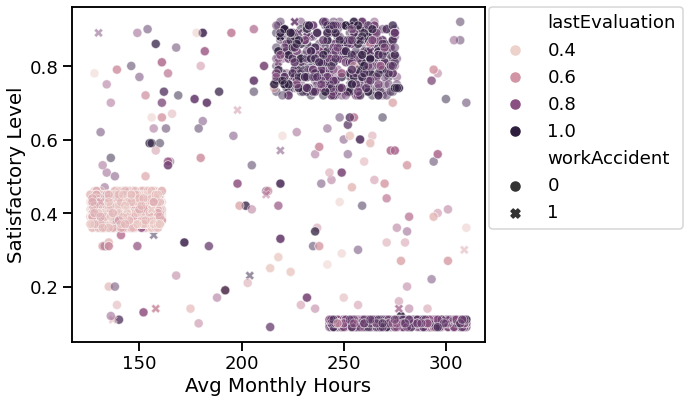

In [42]:
sns.set_context("talk", font_scale=1.1)
plt.figure(figsize=(10,6))
sns.scatterplot(x="avgMonthlyHours", 
                y="satisfactoryLevel",
                hue="lastEvaluation",
                sizes=(20,500),
                alpha=0.5,
                style="workAccident",
                data=hr_leftdata)
# Put the legend out of the figure
plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0)
# Put the legend out of the figure
#plt.legend(bbox_to_anchor=(1.01, 0.54),  borderaxespad=0.)
plt.xlabel("Avg Monthly Hours")
plt.ylabel("Satisfactory Level")
#plt.title()
plt.tight_layout()
 
plt.savefig("Bubble_plot_Seaborn_color_by_variable_Seaborn_scatterplot.png",
                    format='png',dpi=150)

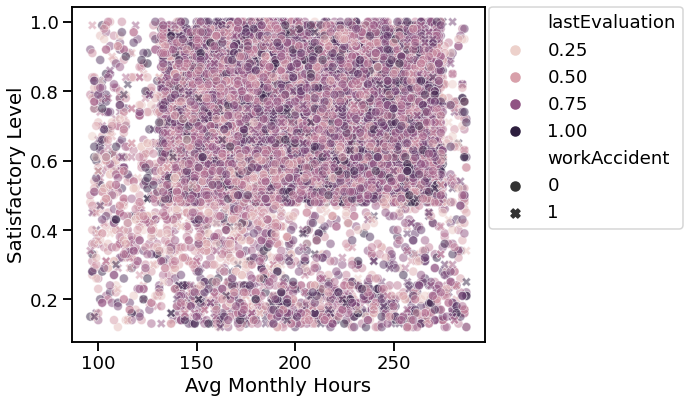

In [41]:
sns.set_context("talk", font_scale=1.1)
plt.figure(figsize=(10,6))
sns.scatterplot(x="avgMonthlyHours", 
                y="satisfactoryLevel",
                hue="lastEvaluation",
                sizes=(20,500),
                alpha=0.5,
                style="workAccident",
                data=hr_staydata)
# Put the legend out of the figure
plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0)
# Put the legend out of the figure
#plt.legend(bbox_to_anchor=(1.01, 0.54),  borderaxespad=0.)
plt.xlabel("Avg Monthly Hours")
plt.ylabel("Satisfactory Level")
#plt.title()
plt.tight_layout()
 
plt.savefig("Bubble_plot_Seaborn_color_by_variable_Seaborn_scatterplot.png",
                    format='png',dpi=150)

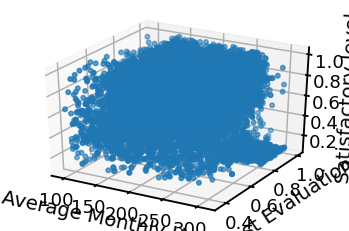

In [38]:
fig=plt.figure()
ax=fig.add_subplot(111,projection='3d')
x_vals=hr_data['avgMonthlyHours']
y_vals=hr_data['lastEvaluation']
z_vals=hr_data['satisfactoryLevel']
ax.scatter(x_vals,y_vals,z_vals)
ax.set_xlabel('Average Monthly Hours')
ax.set_ylabel('Last Evaluation')
ax.set_zlabel('Satisfactory level')
plt.show()

In [32]:
x_vals

0        157
1        262
2        272
3        159
4        153
        ... 
14994    275
14995    274
14996    175
14997    177
14998    271
Name: avgMonthlyHours, Length: 14999, dtype: int64

In [3]:
new_data=pd.get_dummies(hr_data)
hr_data
new_data

,satisfactoryLevel,lastEvaluation,numberOfProjects,avgMonthlyHours,timeSpent.company,workAccident,left,promotionInLast5years,dept_IT,dept_RandD,...,dept_hr,dept_management,dept_marketing,dept_product_mng,dept_sales,dept_support,dept_technical,salary_high,salary_low,salary_medium
0,0.38,0.53,2,157,3,0,1,0,0,0,...,0,0,0,0,1,0,0,0,1,0
1,0.80,0.86,5,262,6,0,1,0,0,0,...,0,0,0,0,1,0,0,0,0,1
2,0.11,0.88,7,272,4,0,1,0,0,0,...,0,0,0,0,1,0,0,0,0,1
3,0.37,0.52,2,159,3,0,1,0,0,0,...,0,0,0,0,1,0,0,0,1,0
4,0.41,0.50,2,153,3,0,1,0,0,0,...,0,0,0,0,1,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14994,0.11,0.85,7,275,4,0,1,0,0,0,...,0,0,0,0,0,1,0,0,0,1
14995,0.99,0.83,4,274,2,0,0,0,0,0,...,0,0,0,0,1,0,0,0,1,0
14996,0.72,0.72,4,175,4,0,0,0,0,0,...,0,0,0,0,0,0,1,0,1,0
14997,0.24,0.91,5,177,5,0,0,0,0,0,...,0,0,0,0,1,0,0,0,1,0


In [83]:
# Storing the column names 
columns_list=list(new_data.columns)
print(columns_list)

['satisfactoryLevel', 'lastEvaluation', 'numberOfProjects', 'avgMonthlyHours', 'timeSpent.company', 'workAccident', 'left', 'promotionInLast5years', 'dept_IT', 'dept_RandD', 'dept_accounting', 'dept_hr', 'dept_management', 'dept_marketing', 'dept_product_mng', 'dept_sales', 'dept_support', 'dept_technical', 'salary_high', 'salary_low', 'salary_medium']


In [84]:
# Separating the input names from data
features=list(set(columns_list)-set(['left']))
features

['dept_RandD',
 'dept_accounting',
 'dept_IT',
 'salary_high',
 'dept_management',
 'dept_marketing',
 'dept_hr',
 'dept_product_mng',
 'dept_sales',
 'satisfactoryLevel',
 'workAccident',
 'lastEvaluation',
 'dept_support',
 'dept_technical',
 'avgMonthlyHours',
 'promotionInLast5years',
 'salary_medium',
 'numberOfProjects',
 'timeSpent.company',
 'salary_low']

In [85]:
#new_features=['satisfactoryLevel','lastEvaluation','timeSpent.company','workAccident','dept_hr','dept_RandD','dept_management','salary_low','salary_high']
x = new_data[features].values

# Storing the output values in y
y=new_data['left'].values
y

array([1, 1, 1, ..., 0, 0, 0], dtype=int64)

In [86]:
train_x,test_x,train_y,test_y = train_test_split(x, y, test_size=0.3, random_state=0)


In [91]:
#Make an instance of the Model
logistic = LogisticRegression()

# Fitting the values for x and y
logistic.fit(train_x,train_y)
logistic.coef_
logistic.intercept_

C:\Anaconda\lib\site-packages\sklearn\linear_model\_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


array([-0.28798385])

In [92]:
# Prediction from test data
prediction = logistic.predict(test_x)
print(prediction)


[0 0 0 ... 0 0 0]


[[3152  253]
 [ 698  397]]


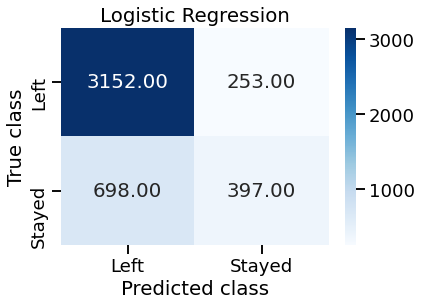

In [101]:
# Confusion matrix
confusion_matrix = confusion_matrix(test_y, prediction)
print(confusion_matrix)
import seaborn as sns
sns.heatmap(confusion_matrix, annot=True,fmt='.2f',xticklabels = ["Left", "Stayed"] , yticklabels = ["Left", "Stayed"],cmap='Blues')
plt.ylabel('True class')
plt.xlabel('Predicted class')
plt.title('Logistic Regression')
plt.savefig('logistic_regression_Conf_matrix')


In [102]:
# Calculating the accuracy
accuracy_score=accuracy_score(test_y, prediction)
print(accuracy_score)



0.7886666666666666


In [103]:
# Printing the misclassified values from prediction

print('Misclassified samples: %d' % (test_y != prediction).sum())

Misclassified samples: 951


# Random Forest

In [104]:
features

['dept_RandD',
 'dept_accounting',
 'dept_IT',
 'salary_high',
 'dept_management',
 'dept_marketing',
 'dept_hr',
 'dept_product_mng',
 'dept_sales',
 'satisfactoryLevel',
 'workAccident',
 'lastEvaluation',
 'dept_support',
 'dept_technical',
 'avgMonthlyHours',
 'promotionInLast5years',
 'salary_medium',
 'numberOfProjects',
 'timeSpent.company',
 'salary_low']

Accuracy Random forest 0.9917777777777778
[[3398    7]
 [  30 1065]]


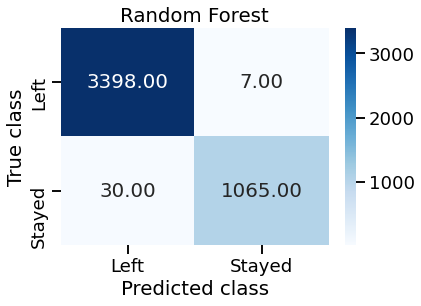

In [121]:
x = new_data[features].values

# Storing the output values in y
y=new_data['left'].values
y
train_x1,test_x1,train_y1,test_y1 = train_test_split(x, y, test_size=0.3, random_state=0)
from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier(n_estimators=100)
rf.fit(train_x1, train_y1)
y_pred=rf.predict(test_x1)
print("Accuracy Random forest",accuracy_score(test_y1,y_pred))
confusion_matrix = confusion_matrix(test_y1, y_pred)
print(confusion_matrix)
import seaborn as sns
sns.heatmap(confusion_matrix, annot=True,fmt='.2f',xticklabels = ["Left", "Stayed"] , yticklabels = ["Left", "Stayed"],cmap='Blues')
plt.ylabel('True class')
plt.xlabel('Predicted class')
plt.title('Random Forest')
plt.savefig('Random_forestwithoutfeaturereduction_Conf_matrix')

In [109]:
import pandas as pd
feature_imp=pd.Series(rf.feature_importances_,index=features).sort_values(ascending=False)
feature_imp

satisfactoryLevel        0.311270
numberOfProjects         0.187103
timeSpent.company        0.174242
avgMonthlyHours          0.154013
lastEvaluation           0.125794
workAccident             0.009951
salary_low               0.006747
salary_high              0.004800
salary_medium            0.003635
dept_technical           0.003628
dept_sales               0.003387
dept_support             0.002966
dept_IT                  0.001876
dept_RandD               0.001786
dept_management          0.001763
dept_accounting          0.001602
dept_hr                  0.001522
promotionInLast5years    0.001379
dept_product_mng         0.001348
dept_marketing           0.001186
dtype: float64

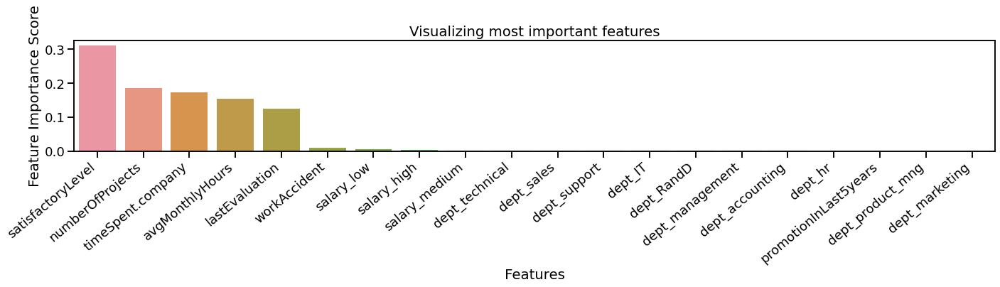

<Figure size 432x288 with 0 Axes>

In [123]:
plt.figure(figsize=(20,5))
ax=sns.barplot(y=feature_imp,x=feature_imp.index)
ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")
plt.tight_layout()
plt.ylabel("Feature Importance Score")
plt.xlabel("Features")
plt.title("Visualizing most important features")
plt.show()
plt.savefig('Feature_importance_graph')

Accuracy on train data: 0.9997142585008096
Accuracy on test data after feature reduction: 0.992
Training confusion matrix:
[[8020    3]
 [   0 2476]]
Test confusion matrix:
[[3399    6]
 [  30 1065]]


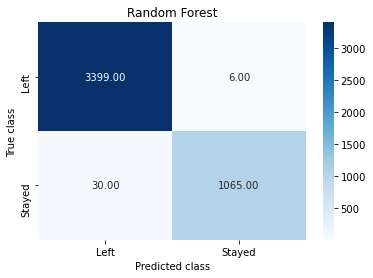

In [9]:
reduced_features=['satisfactoryLevel','lastEvaluation','timeSpent.company','avgMonthlyHours','numberOfProjects']
x = new_data[reduced_features].values

# Storing the output values in y
y=new_data['left'].values
y
train_x1,test_x1,train_y1,test_y1 = train_test_split(x, y, test_size=0.3, random_state=0)
from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier(n_estimators=100)
rf.fit(train_x1, train_y1)
y_pred=rf.predict(test_x1)
traindatapred=rf.predict(train_x1)
print("Accuracy on train data:",accuracy_score(train_y1,traindatapred))
print("Accuracy on test data after feature reduction:",accuracy_score(test_y1,y_pred))
confusion_matrixtrain = confusion_matrix(train_y1, traindatapred)
print("Training confusion matrix:")
print(confusion_matrixtrain)
confusion_matrix = confusion_matrix(test_y1, y_pred)
print("Test confusion matrix:")
print(confusion_matrix)
import seaborn as sns
sns.heatmap(confusion_matrix, annot=True,fmt='.2f',xticklabels = ["Left", "Stayed"] , yticklabels = ["Left", "Stayed"],cmap='Blues')
plt.ylabel('True class')
plt.xlabel('Predicted class')
plt.title('Random Forest')
plt.savefig('Random_forest_Conf_matrix')